# Imports

In [1]:
import matplotlib
matplotlib.use('Agg')
%matplotlib inline
import matplotlib.pyplot as plt
from sodetlib.det_config import DetConfig
import yaml
import time
import pickle as pkl
import os
import numpy as np
from matplotlib import cm
from scipy.signal import welch,periodogram
import pandas as pd
import glob
from scipy.optimize import curve_fit

import sodetlib.smurf_funcs.smurf_ops as so
import sodetlib.util as su
import sodetlib.smurf_funcs.optimize_params as op
from sodetlib.util import get_tracking_kwargs
from sodetlib.util import get_wls_from_am
from sodetlib.analysis import squid_fit as sqf
from tqdm import tqdm

In [2]:
cfg = DetConfig()
cfg.load_config_files(slot=2)
S = cfg.get_smurf_control(make_logfile=True)
print(f"Logfile: {S.log.logfile.name}")

Logfile: /data/smurf_data/20211013/1634158282/outputs/1634158282.log


In [3]:
S.set_mode_dc()

In [4]:
S.get_cryo_card_ac_dc_mode()

'DC'

In [5]:
S.reset_rtm()

In [6]:
S.setup()

True

#  Amplifier Biases and Health Check

In [8]:
S.C.write_ps_en(3)

In [7]:
S.set_hemt_gate_voltage(0.282)
S.set_50k_amp_gate_voltage(0.0)

In [9]:
S.get_amplifier_biases()

{'hemt_Vg': 0.28199809000000003,
 'hemt_Id': 2.8681609374999995,
 '50K_Vg': 0.0,
 '50K_Id': 21.527362499999995}

# Setup from `dev_cfg`

In [13]:
bad_trackers = [22,24,281]

In [23]:
band = 0
bcfg = cfg.dev.bands[band]
tk = su.get_tracking_kwargs(S,cfg,band)
tk['show_plot'] = False
S.load_tune(cfg.dev.exp['tunefile'])
S.set_att_uc(band,bcfg['uc_att'])
S.set_att_dc(band,bcfg['dc_att'])

# Phase Delays

In [27]:
S.estimate_phase_delay(band,make_plot=True,save_plot=True,show_plot=False)

/home/cryo/.local/lib/python3.6/site-packages/scipy/signal/spectral.py:1812: UserWarning: Input data is complex, switching to return_onesided=False
  warnings.warn('Input data is complex, switching to '


-------------------------------------------------------
Estimated refPhaseDelay=21
Estimated refPhaseDelayFine=107
Estimated processing_delay_us=7.66868244629757
-------------------------------------------------------


(21, 107, 7.66868244629757, 0.06653316702504666)

In [28]:
S.get_ref_phase_delay(band)

21

In [29]:
S.get_ref_phase_delay_fine(band)

107

# Reset up functions

In [51]:
S.all_off()

In [52]:
band = 0
S.set_feedback_enable(band,1)
S.set_lms_enable1(band,1)
S.set_lms_enable2(band,1)
S.set_lms_enable3(band,1)

In [53]:
tunefile = '/data/smurf_data/tune/1634162881_tune.npy'
bad_trackers = [24,281]
band = 0
S.set_ref_phase_delay(band, 21)
S.set_ref_phase_delay_fine(band, 107)
S.set_att_uc(band,0)
S.set_att_dc(band,6)
S.load_tune(tunefile)
#S.relock(band)
S.setup_notches(band,tone_power=12,new_master_assignment=False)
for ch in bad_trackers:
    S.channel_off(band,ch)
for _ in range(2):
    S.run_serial_gradient_descent(band)
    S.run_serial_eta_scan(band)
tk = get_tracking_kwargs(S, cfg, band)
tk['show_plot'] = False
tk['channel'] = S.which_on(band)
_ = S.tracking_setup(band, feedback_gain = 256,**tk)

(array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.27858734e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.33580780e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.39302826e-05],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 6.76631927e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 6.82353973e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 6.88076019e-05]]),
 array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.24997711e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.30719757e-05],
        [0.00000000e+00, 

## If everything on

In [45]:
S.setup_notches(band,new_master_assignment=False)
for ch in bad_trackers:
    S.channel_off(band,ch)
for _ in range(2):
    S.run_serial_gradient_descent(band)
    S.run_serial_eta_scan(band)
tk = get_tracking_kwargs(S, cfg, band)
tk['show_plot'] = False
tk['channel'] = S.which_on(band)
S.tracking_setup(band, feedback_gain = 256,**tk)

(array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.84807587e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.90529633e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.96251678e-05],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.33580780e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.39302826e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 5.45024872e-05]]),
 array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.81946564e-05],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.87668610e-05],
        [0.00000000e+00, 

# Check Noise fn

In [12]:
def check_noise(band):
    sid = so.take_g3_data(S,30)
    aman = so.load_session(cfg, session_id = sid)
    wls, bm = get_wls_from_am(aman)
    plt.figure()
    plt.hist(wls[wls < 200], bins = 20,alpha = 0.5,label = 'Noise per Channel')
    print(bm[band])
    plt.axvline(bm[band],ls = ':',color = 'C1',lw = 3,label = 
                f'Band Median:\n{np.round(bm[band],2)}'+' pA/$\sqrt{Hz}$')
    plt.xlabel('NEI [pA/$\sqrt{Hz}$]',fontsize = 16)
    plt.ylabel('Counts',fontsize = 16)
    plt.legend(fontsize = 16)
    fig = plt.gcf()
    fig.patch.set_facecolor('white')
    return sid, aman, wls, bm

In [13]:
def to_pA(s):
    return 9e6*s/(2*np.pi)

100%|██████████| 1/1 [00:00<00:00, 103.71it/s]
/home/cryo/.local/lib/python3.6/site-packages/scipy/signal/spectral.py:1963: UserWarning: nperseg = 65536 is greater than input length  = 6496, using nperseg = 6496
  .format(nperseg, input_length))
/home/cryo/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/cryo/.local/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


36.26205062866211


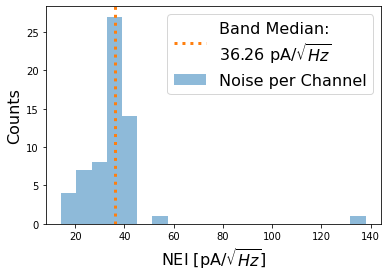

In [54]:
sid, aman, wls, bm = check_noise(band)

# Tuning $\eta$'s & $f_r$'s 

In [84]:
chans_on = S.which_on(band)
res_chs_map = np.asarray([S.freq_resp[band]['resonances'][key]['channel'] for key in range(len(S.freq_resp[band]['resonances'].keys()))])
etas_sn = np.asarray([S.freq_resp[band]['resonances'][np.where(res_chs_map == ch)[0][0]]['eta_phase'] for ch in chans_on])
etas_ses = np.asarray([S.get_eta_phase_degree_channel(band,ch) for ch in chans_on])
freqs_sn = np.asarray([S.freq_resp[band]['resonances'][np.where(res_chs_map == ch)[0][0]]['freq'] for ch in chans_on])
freqs_ses = np.asarray([S.channel_to_freq(band,ch) for ch in chans_on])

In [80]:
def diff_ang(a1,a2):
    a = a1 - a2
    a = (a + 180) % 360 - 180
    return a

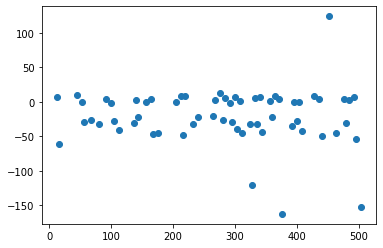

In [83]:
plt.plot(chans_on,diff_ang(etas_ses,etas_sn),'o')

In [94]:
freqs_diff = [freqs_ses[np.argmin(np.abs(S.freq_resp[band]['resonances'][np.where(res_chs_map == ch)[0][0]]['freq'] - freqs_ses))] for ch in chans_on]
freqs_diff_idx = [np.argmin(np.abs(S.freq_resp[band]['resonances'][np.where(res_chs_map == ch)[0][0]]['freq'] - freqs_ses)) for ch in chans_on]

(0.001, 10000)

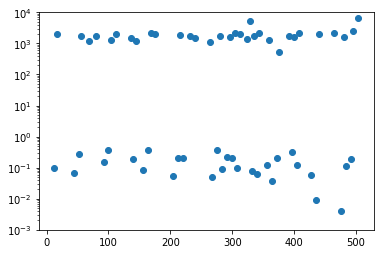

In [93]:
plt.plot(chans_on,np.abs(freqs_ses-freqs_sn)*1e3,'o')
plt.yscale('log')
plt.ylim(1e-3,10000)

These aren't matching...let's just take data and get the etas and freqs using the same functions

100%|██████████| 1/1 [00:00<00:00, 107.05it/s]
/home/cryo/.local/lib/python3.6/site-packages/scipy/signal/spectral.py:1963: UserWarning: nperseg = 65536 is greater than input length  = 6489, using nperseg = 6489
  .format(nperseg, input_length))
/home/cryo/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/cryo/.local/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


35.86878204345703


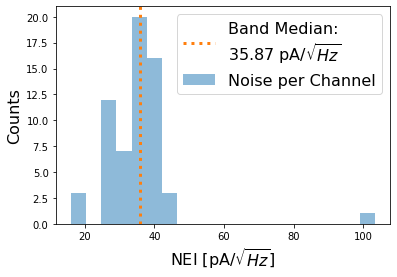

In [136]:
S.all_off()
tunefile = '/data/smurf_data/tune/1634162881_tune.npy'
bad_trackers = [24,281]
band = 0
S.set_ref_phase_delay(band, 21)
S.set_ref_phase_delay_fine(band, 107)
S.set_att_uc(band,0)
S.set_att_dc(band,6)
S.load_tune(tunefile)
#S.relock(band)
S.setup_notches(band,tone_power=12,new_master_assignment=False)
for ch in bad_trackers:
    S.channel_off(band,ch)
chans_on = S.which_on(band)
etas_sn = np.asarray([S.get_eta_phase_degree_channel(band,ch) for ch in chans_on])
freqs_sn = np.asarray([S.channel_to_freq(band,ch) for ch in chans_on])
for _ in range(2):
    S.run_serial_gradient_descent(band)
    S.run_serial_eta_scan(band)
etas_ses = np.asarray([S.get_eta_phase_degree_channel(band,ch) for ch in chans_on])
freqs_ses = np.asarray([S.channel_to_freq(band,ch) for ch in chans_on])
tk = get_tracking_kwargs(S, cfg, band)
tk['show_plot'] = False
tk['channel'] = S.which_on(band)
_ = S.tracking_setup(band, feedback_gain = 256,**tk)
sid, aman, wls, bm = check_noise(band)

Text(0, 0.5, 'Difference in $\\angle\\eta$ [$^{\\circ}$]\n(serial_eta_scan)-(setup_notches)')

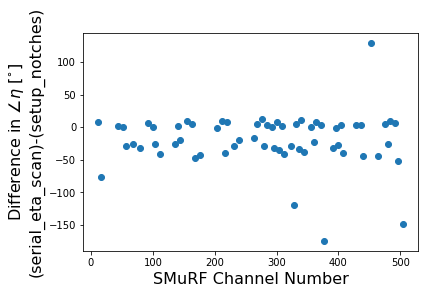

In [144]:
plt.plot(chans_on,diff_ang(etas_ses,etas_sn),'o')
plt.xlabel('SMuRF Channel Number',fontsize = 16)
plt.ylabel('Difference in $\\angle\\eta$ [$^{\\circ}$]\n(serial_eta_scan)-(setup_notches)',fontsize = 16)

Text(0, 0.5, 'Difference in $f_r$ [Hz]\n(serial_eta_scan)-(setup_notches)')

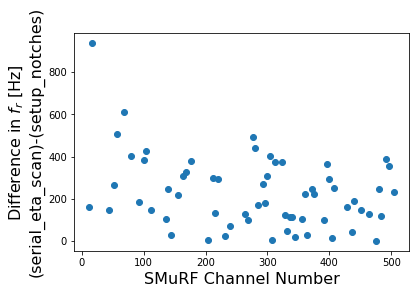

In [146]:
plt.plot(chans_on,np.abs(freqs_ses-freqs_sn)*1e6,'o')
plt.xlabel('SMuRF Channel Number',fontsize = 16)
plt.ylabel('Difference in $f_r$ [Hz]\n(serial_eta_scan)-(setup_notches)',fontsize = 16)

# Fit Resonator Transmission

## Imports

In [ ]:
S.load_tune()

In [147]:
cd /sodetlib/scripts

/sodetlib/scripts


In [148]:
import resonator_fitting

In [149]:
def one_resonator_fitting_new(tunefile):
    """
    Automated fitting of resonator parameters from one tunning file.
    ----------
    tunefile : str
    Full directories of one tunning file. 		  
    Returns
    -------
    dfres : dataframe
    a pandas dataframe consisting of columns:ctime, resonator_index, f0, Qi, Qc, Q, br, depth.
    """    
    dres = {'time':[],'resonator_index':[], 'f0':[], 'Qi':[], 
            'Qc':[],'Q':[],'br': [],'depth':[]}
    resdict = {}
    dfres =pd.DataFrame(dres)
    data=np.load(tunefile,allow_pickle=True).item()
    for band in list(data.keys()):
        if 'resonances' in list(data[band].keys()):
            for idx in list(data[band]['resonances'].keys()):
                scan=data[band]['resonances'][idx]
                f=scan['freq_eta_scan']
                s21=scan['resp_eta_scan']
                result=full_fit(f,s21.real,s21.imag)
                f0 = result.best_values['f_0']
                Q = result.best_values['Q']
                Qc = result.best_values['Q_e_real']
                Qi = get_qi(result.best_values['Q'], result.best_values['Q_e_real'])
                br = get_br(result.best_values['Q'], result.best_values['f_0'])
                res_index = scan['channel']+band*512
                resdict[res_index] = result
                time=data[band]['find_freq']['timestamp'][0]
                s21_mag=np.abs(result.best_fit.real+1j*result.best_fit.imag)
                depth = max(s21_mag)-min(s21_mag)
                dfres = dfres.append({'time':time,'resonator_index': int(res_index), 'f0': f0, 'Qi': Qi, 
                    'Qc': Qc, 'Q': Q, 'br':br, 'depth':depth}, ignore_index=True)
    return dfres, resdict

def resonator_fitting_new(S,tunefile):
    """
    Automated fitting of resonator parameters from tunning files
    ----------
    tunefile : str array
        Full directories of tunning files. Can be one file or an array of multiple files.  		  
    Returns
    -------
    df_param : dataframe
        a pandas dataframe consisting of columns:ctime, resonator_index, f0, Qi, Qc, Q, br, depth.
    """
    if np.array([tunefile]).size==1:
        df_param, resdict=one_resonator_fitting_new(tunefile)
    elif np.array([tunefile]).size>1:
        df_param=pd.DataFrame( {'time':[],'resonator_index':[], 'f0':[], 'Qi':[], 
                'Qc':[],'Q':[],'br': [],'depth':[]})
        resdict = {}
        for onefile in list(tunefile):
            f,resdict[onefile]=one_resonator_fitting_new(onefile)
            df_param=df_param.append(f)
    return df_param, resdict

In [150]:
def fr_deriv(f_0,Q,Q_e_real,Q_e_imag,delay,phi,f_min,A_mag,A_slope):
    f0 = f_0
    Qer = Q_e_real
    Qei = Q_e_imag
    fmin = f_min
    Amag = A_mag
    Aslope = A_slope
    d = (2j*Amag*np.exp(1j*(phi - 2*delay*(f0-fmin)*np.pi))*(1 + Aslope*(f0 - fmin))*Q**2)/(f0*(1j*Qei+Qer))+\
    Amag*Aslope*np.exp(1j*(phi - 2*delay*(f0 - fmin)*np.pi))*(1 - Q/(1j*Qei + Qer)) -\
    2*1j*Amag*delay*np.exp(1j*(phi - 2*delay*(f0 - fmin)*np.pi))*(1 + Aslope*(f0 - fmin))*np.pi*(1 - Q/(1j*Qei + Qer))
    return d

## Fitting

In [151]:
from resonator_model import *
dfout,resultdict = resonator_fitting_new(S,S.tune_file)

In [152]:
%matplotlib inline

## Plot All 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


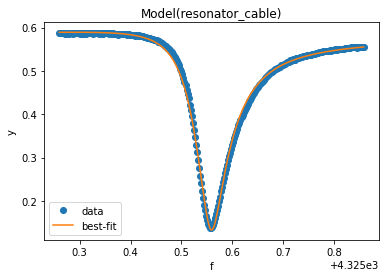

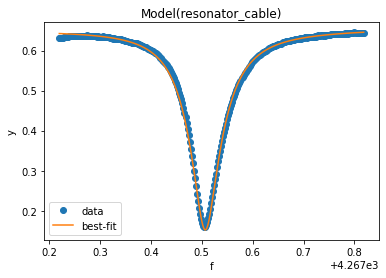

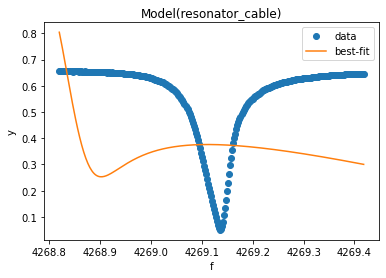

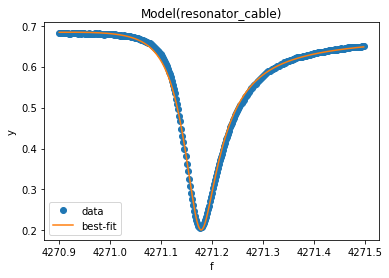

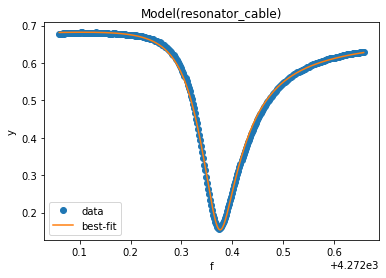

...

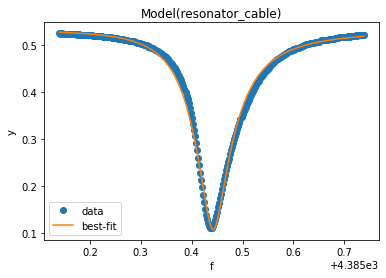

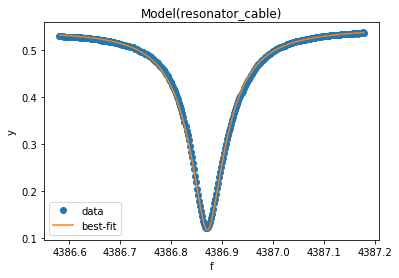

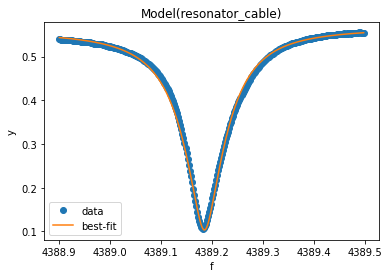

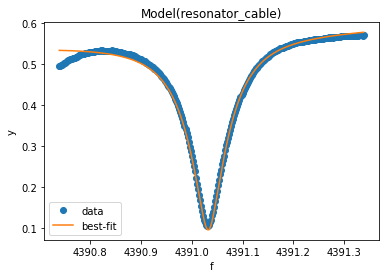

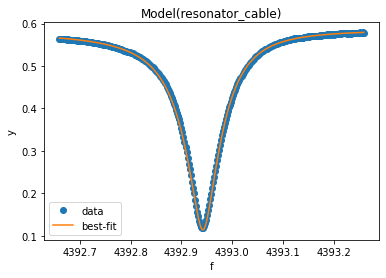

In [153]:
for key in resultdict.keys():
    plt.figure()
    resultdict[key].plot_fit()

### IQ Circles

In [154]:
def rot_compl(v,etas,ang):
    rot_i = np.cos(np.angle(etas))*np.real(v) - np.sin(np.angle(etas))*np.imag(v)
    rot_q = np.sin(np.angle(etas))*np.real(v) + np.cos(np.angle(etas))*np.imag(v)
    return rot_i, rot_q

In [172]:
S.tune_file

'/data/smurf_data/tune/1634169791_tune.npy'

In [168]:
len(res_chs_map)

67

In [170]:
resultdict.keys()

dict_keys([-1, 281, 480, 16, 144, 400, 80, 336, 464, 304, 176, 112, 240, 496, 264, 136, 392, 328, 296, 168, 104, 360, 232, 24, 280, 408, 344, 216, 56, 312, 440, 376, 504, 68, 324, 452, 292, 164, 100, 356, 484, 276, 404, 340, 212, 52, 308, 436, 372, 12, 268, 140, 396, 332, 204, 44, 300, 428, 364, 492, 284, 156, 92, 220, 476])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


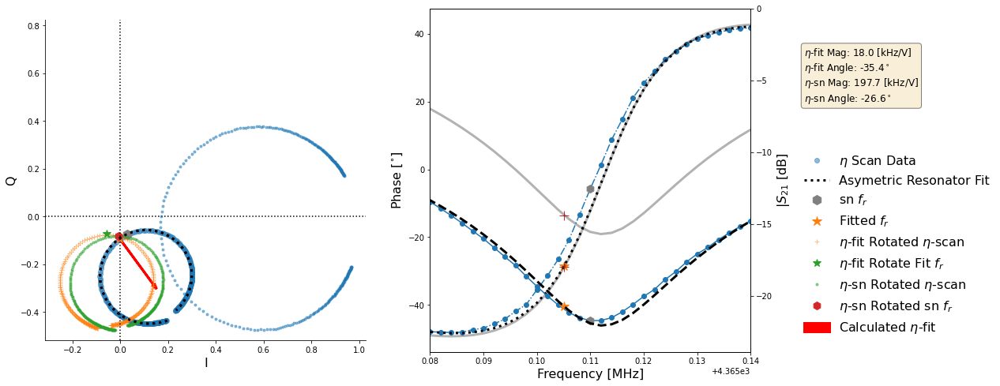

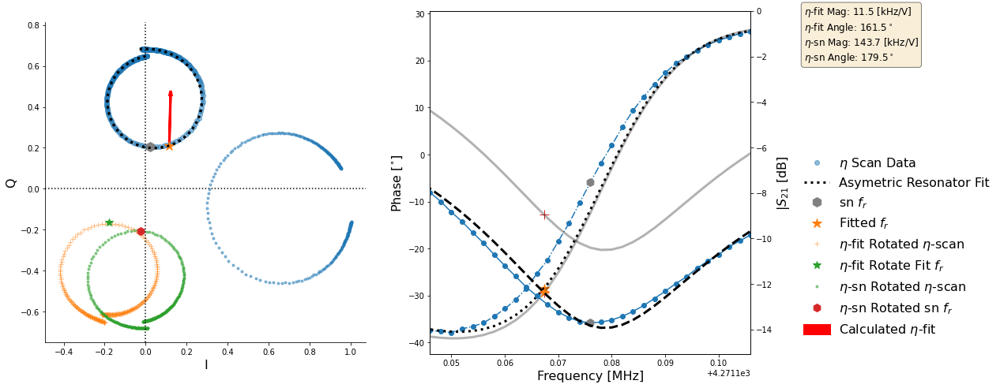

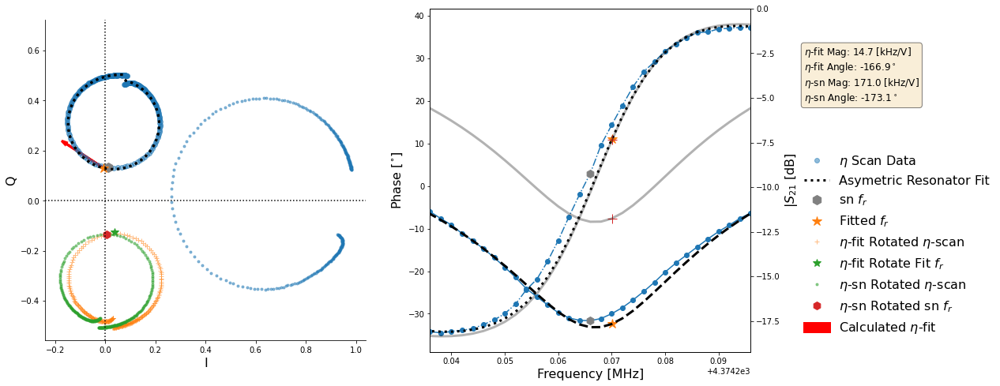

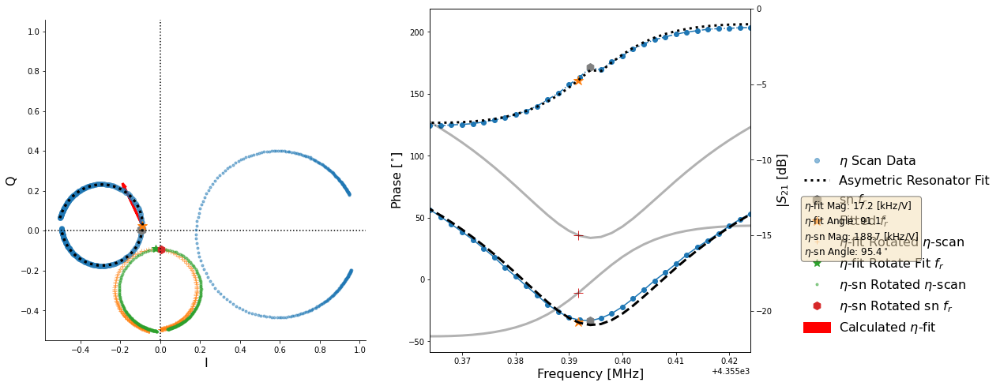

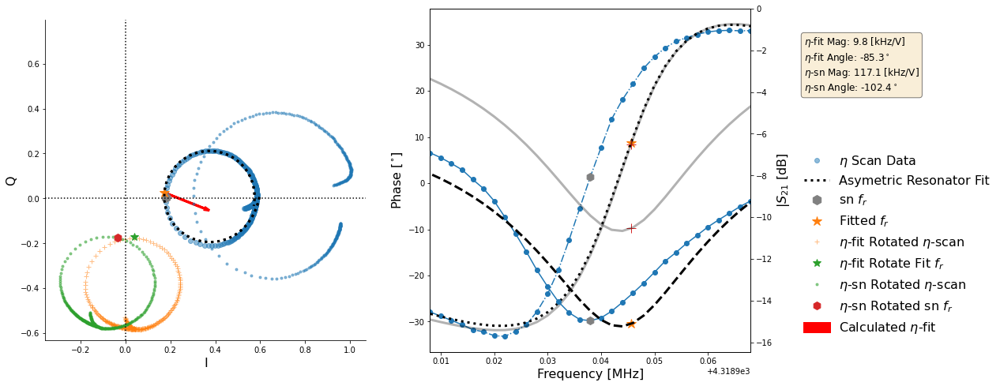

...

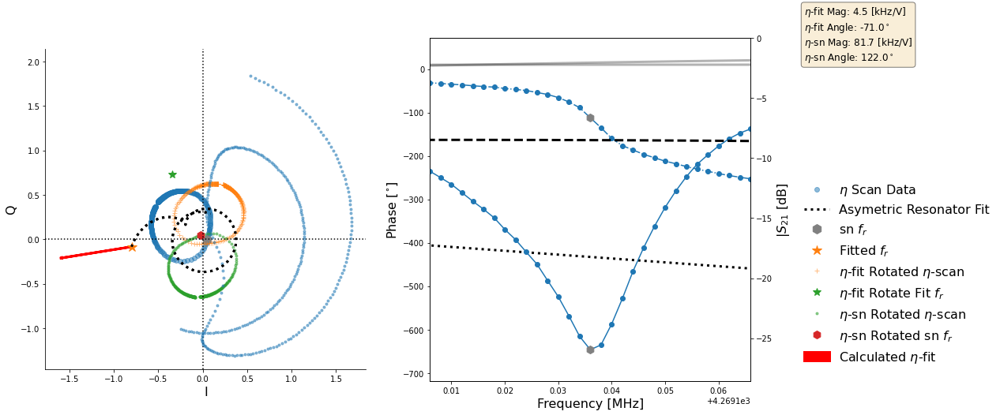

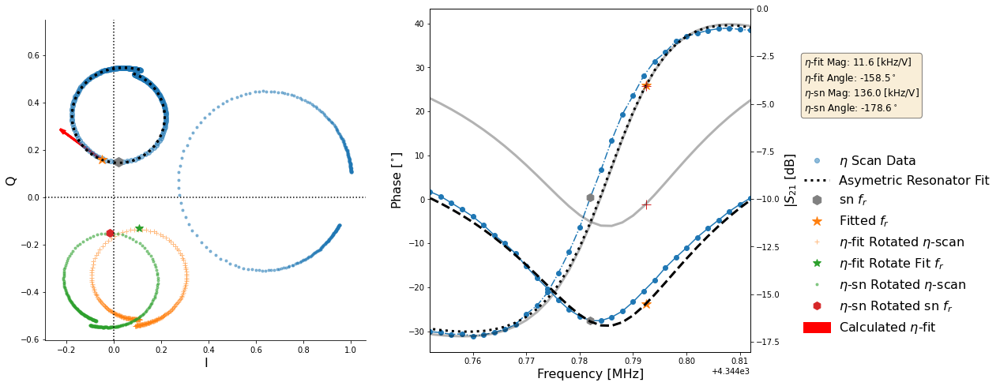

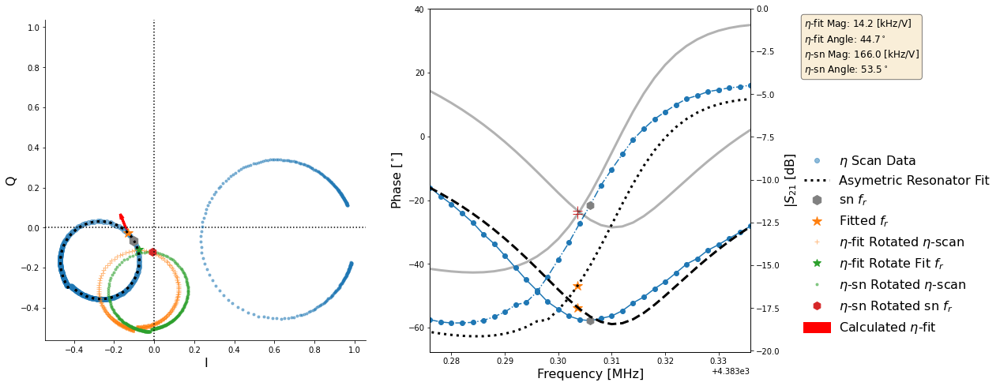

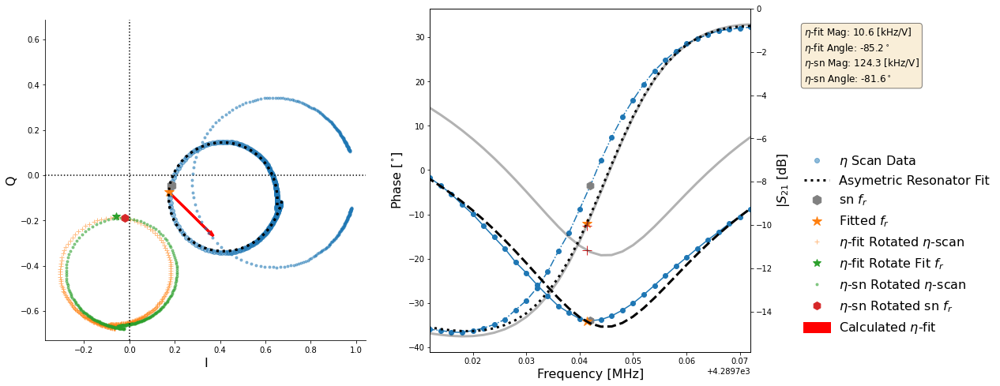

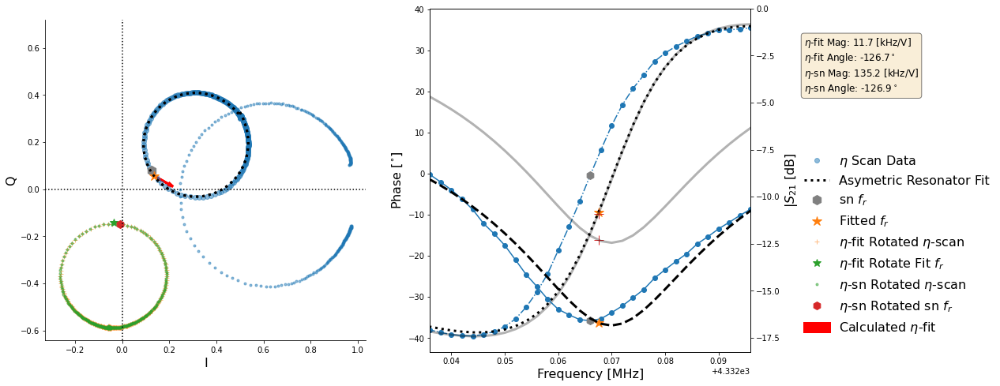

In [178]:
tunedict = np.load(S.tune_file,allow_pickle=True).item()
chan_sn = np.asarray([tunedict[band]['resonances'][key]['channel'] for key in tunedict[band]['resonances'].keys()])
#plt.figure(figsize = (30,30))
nplt = 1
etas_fit = np.zeros(len(chans_on),dtype=complex)
for ix, k in enumerate(chans_on):
    #plt.subplot(8,8,nplt)
    plt.figure(figsize = (16,8))
    plt.subplot(1,2,1)
    snch = np.where(chan_sn == k)[0][0]
    fpl = tunedict[band]['resonances'][snch]['freq_eta_scan']
    rpl = tunedict[band]['resonances'][snch]['resp_eta_scan']
    if np.ptp(20*np.log10(np.abs(rpl))) < 1:
        continue
    fidx = np.argmin(np.abs(fpl-tunedict[band]['resonances'][snch]['freq']))
    plt.plot(np.real(rpl),np.imag(rpl),'o',
             label = '$\\eta$ Scan Data',alpha = 0.5)
    plt.plot(np.real(resultdict[k+512*band].best_fit),np.imag(resultdict[k+512*band].best_fit),
             'k:',label = 'Asymetric Resonator Fit',lw = 3)
    rdc = resultdict[k+512*band].best_values
    minfit = resonator_cable(resultdict[k+512*band].best_values['f_0'],**rdc)
    minsn = rpl[fidx]
    plt.plot(np.real(minsn),np.imag(minsn),
         'h',color ='grey',markersize=12,label = 'sn $f_r$')
    plt.plot(np.real(minfit),np.imag(minfit),
         '*',color ='C1',label = 'Fitted $f_r$',
         markersize=12)
    b = fr_deriv(**rdc)
    etas_fit[ix] = 1/b
    arr = minfit + 1/b
    ax = plt.gca()
    plt.arrow(np.real(minfit),np.imag(minfit),
             np.real(arr),np.imag(arr),
             head_width = 0.01, head_length = 0.02,
             fc = 'red',ec = 'red',lw = 3,label = 'Calculated $\\eta$-fit')
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    rpl_rot_i, rpl_rot_q = rot_compl(rpl,etas_fit[ix])
    minstar_i, minstar_q = rot_compl(np.real(minfit) + 1j*np.imag(minfit),etas_fit[ix])
    
    rpl_snrot_i,rpl_snrot_q = rot_compl(rpl,tunedict[band]["resonances"][snch]["eta"])
    minhex_i,minhex_q = rot_compl(minsn,tunedict[band]["resonances"][snch]["eta"])
    
    plt.plot(rpl_rot_i,rpl_rot_q,'C1+',alpha = 0.5,label = '$\\eta$-fit Rotated $\\eta$-scan')
    plt.plot(minstar_i,minstar_q,'C2*',markersize=10,label = '$\\eta$-fit Rotate Fit $f_r$')
    
    plt.plot(rpl_snrot_i,rpl_snrot_q,'C2.',alpha = 0.5,label = '$\\eta$-sn Rotated $\\eta$-scan')
    plt.plot(minhex_i,minhex_q,'C3h',markersize=10,label = '$\\eta$-sn Rotated sn $f_r$')
    
    plt.axhline(0.0,ls = ':', color = 'k')
    plt.axvline(0.0,ls = ':', color = 'k')

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.xlabel('I',fontsize = 16)
    plt.ylabel('Q',fontsize = 16)
    plt.legend(fontsize = 16,
                loc = (2.35,0),frameon=False)
    
    # Resonator S21 vs Freq
    delay = resultdict[k+512*band].best_values['delay']
    phi = resultdict[k+512*band].best_values['phi']
    f_min = resultdict[k+512*band].best_values['f_min']
    A_mag = resultdict[k+512*band].best_values['A_mag']
    A_slope = resultdict[k+512*band].best_values['A_slope']
    f_0 = resultdict[k+512*band].best_values['f_0']
    
    phase_term = np.exp(1j * (-2 * np.pi * (fpl - f_min) * delay + phi))
    magnitude_term = ((fpl-f_min)*A_slope + 1)* A_mag
    cable_term = magnitude_term*phase_term
    mincbl =  np.exp(1j * (-2 * np.pi * (f_0 - f_min) * delay + phi))*\
            ((f_0-f_min)*A_slope + 1)* A_mag
    
    plt.plot(np.real(rpl/cable_term),
             np.imag(rpl/cable_term),'.',color = 'C0',
             label = '$\\eta$ Scan Data\nDivide Cable',alpha = 0.5)
    plt.plot(np.real(resultdict[k+512*band].best_fit),
             np.imag(resultdict[k+512*band].best_fit),
             'k:',label = 'Asymetric Resonator Fit',lw = 3)
    
    plt.axis('square')
    
    #S21 Phase
    plt.subplot(1,2,2)
    #eta scan phase data
    plt.plot(fpl,np.unwrap(np.rad2deg(np.angle(rpl)-np.mean(np.angle(rpl))),discont=180.),
             color = 'C0',marker = 'o',ls = '-.')
    #eta scan phase resonance point
    plt.plot(fpl[fidx],np.rad2deg(np.angle(rpl)-np.mean(np.angle(rpl)))[fidx],'h',
             color = 'grey',markersize = 10)
    #eta scan fit resonance point
    plt.plot(resultdict[k+512*band].best_values['f_0'],
             np.rad2deg(np.angle(minfit)-\
                        np.mean(np.angle(resultdict[k+512*band].best_fit))),
             'C1*',markersize = 12)
    #eta scan fit phase data
    plt.plot(fpl,np.unwrap(np.rad2deg(np.angle(resultdict[k+512*band].best_fit)-\
                           np.mean(np.angle(resultdict[k+512*band].best_fit))),discont=180.),
             'k:',label = 'Asymetric Resonator Fit',lw = 3)
    #eta scan fit phase data cable divided out
    plt.plot(resultdict[k+512*band].best_values['f_0'],
             np.rad2deg(np.angle(minfit/mincbl)-\
                        np.mean(np.angle(resultdict[k+512*band].best_fit/cable_term))),
             'C3+',markersize = 12)
    #eta scan fit resonance point cable divided out
    plt.plot(fpl,np.unwrap(np.rad2deg(np.angle(resultdict[k+512*band].best_fit/cable_term)-\
                           np.mean(np.angle(resultdict[k+512*band].best_fit/cable_term))),
                           discont=180.),
             'k-',label = 'Asymetric Resonator Fit\nCable Removed',lw = 3,alpha = 0.3)    
    
    #plot parameters
    plt.xlim(fpl[fidx] - 0.03,fpl[fidx] + 0.03)
    plt.ylabel('Phase [$^{\\circ}$]',fontsize = 16)
    plt.xlabel('Frequency [MHz]',fontsize = 16)
    plt.text(fpl[fidx]+0.04,20,
         f'$\\eta$-fit Mag: {np.abs(1/b)/1e-2:.1f} [kHz/V]\n$\\eta$-fit Angle: {np.rad2deg(np.angle(1/b)):.1f}$^\\circ$\n'+
         f'$\\eta$-sn Mag: {np.abs(tunedict[band]["resonances"][snch]["eta"])/1e-3:.1f} [kHz/V]\n'+
         f'$\\eta$-sn Angle: {np.rad2deg(np.angle(tunedict[band]["resonances"][snch]["eta"])):.1f}$^\\circ$',
        bbox = props,fontsize = 12)
    
    #S21 magnitude dB
    ax2 = plt.twinx()
    #eta scan magnitude data
    ax2.plot(fpl,20*np.log10(np.abs(rpl)),color = 'C0',
             marker = 'o',ls = '-')
    #eta scan magnitude resonance point
    ax2.plot(fpl[fidx],20*np.log10(np.abs(rpl)[fidx]),'h',
             color = 'grey',markersize = 10)
    #eta scan fit magnitude data
    ax2.plot(resultdict[k+512*band].best_values['f_0'],
             20*np.log10(np.abs(minfit)),
             'C1*',markersize = 12)
    #eta scan fit resonance point
    ax2.plot(fpl,20*np.log10(np.abs(resultdict[k+512*band].best_fit)),
             'k--',label = 'Asymetric Resonator Fit',lw = 3)
    #eta scan fit magnitude data cable divided out
    ax2.plot(resultdict[k+512*band].best_values['f_0'],
             20*np.log10(np.abs(minfit/mincbl)),
             'C3+',markersize = 12)
    #eta scan fit resonance point cable divided out
    ax2.plot(fpl,20*np.log10(np.abs(resultdict[k+512*band].best_fit/cable_term)),
             'k-',label = 'Asymetric Resonator Fit',lw = 3,alpha = 0.3)
    
    #plot parameters
    ax2.set_ylabel('$|S_{21}$ [dB]',fontsize = 16)
    ax2.set_ylim(1.1*20*np.log10(np.abs(rpl)[fidx]),0)
    #1.1*20*np.log10(np.abs(rpl)[fidx+16]))
    nplt += 1

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


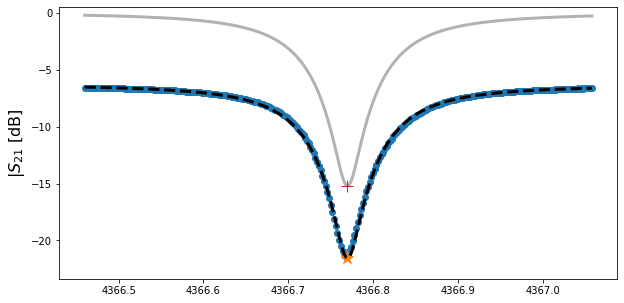

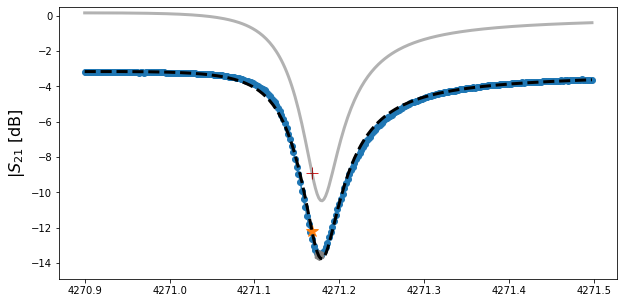

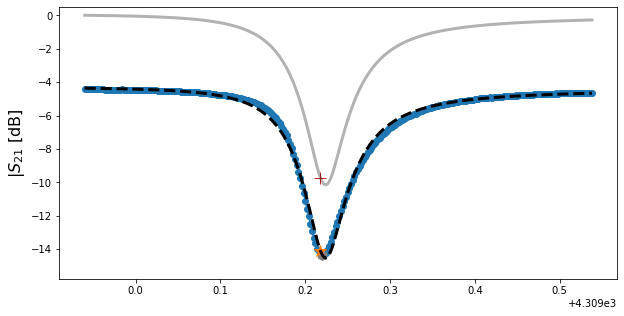

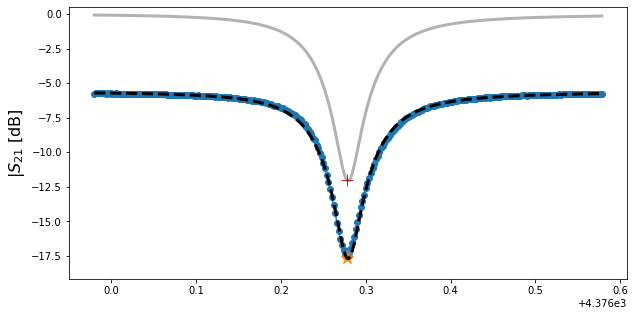

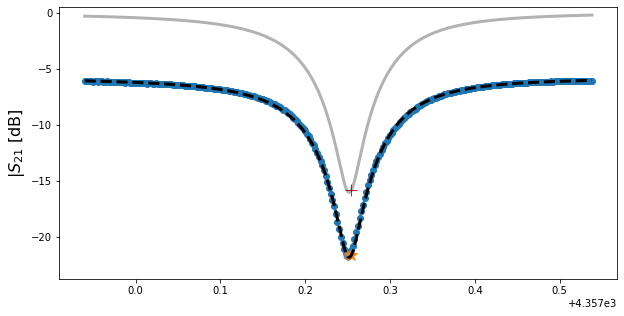

...

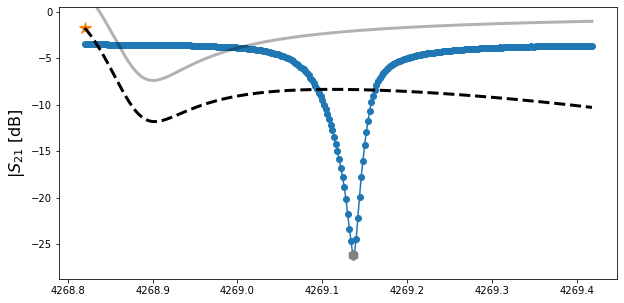

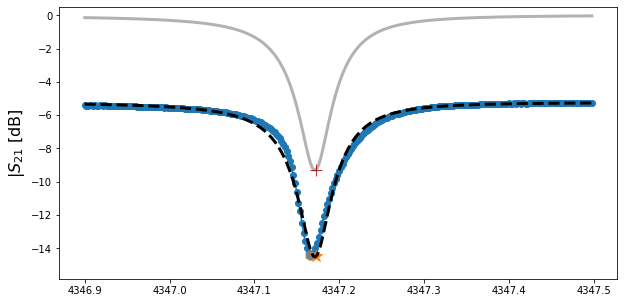

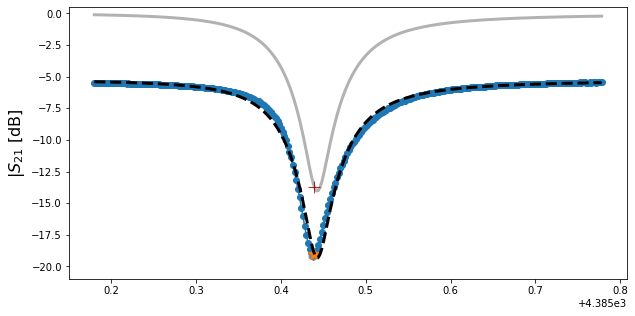

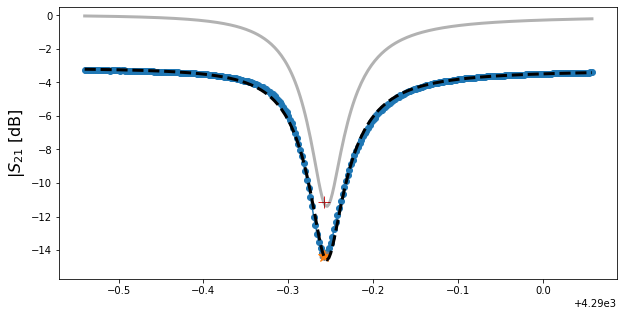

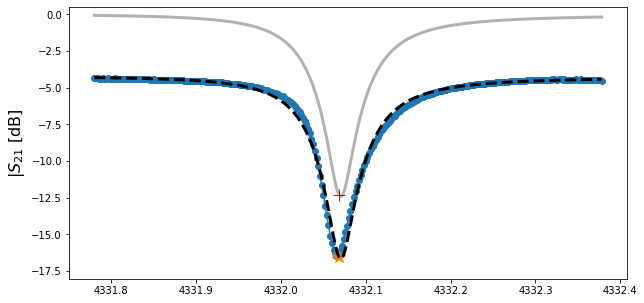

In [274]:
chan_sn = np.asarray([S.freq_resp[band]['resonances'][key]['channel'] for key in S.freq_resp[band]['resonances'].keys()])
etas_fit = {}
for k in S.which_on(band):
    snch = np.where(chan_sn == k)[0][0]
    fpl = S.freq_resp[band]['resonances'][snch]['freq_eta_scan']
    rpl = S.freq_resp[band]['resonances'][snch]['resp_eta_scan']
    if np.ptp(20*np.log10(np.abs(rpl))) < 1:
        continue
    plt.figure(figsize = (10,5))
    ax2 = plt.gca()
    fidx = np.argmin(np.abs(fpl-S.freq_resp[band]['resonances'][snch]['freq']))

    rdc = resultdict[k+512*band].best_values
    minfit = resonator_cable(resultdict[k+512*band].best_values['f_0'],**rdc)
    minsn = rpl[fidx]

    b = fr_deriv(**rdc)
    etas_fit[k] = 1/b
    arr = minfit + 1/b

    rpl_rot_i, rpl_rot_q = rot_compl(rpl,etas_fit[k])
    minstar_i, minstar_q = rot_compl(np.real(minfit) + 1j*np.imag(minfit),etas_fit[k])
    
    rpl_snrot_i,rpl_snrot_q = rot_compl(rpl,S.freq_resp[band]["resonances"][snch]["eta"])
    minhex_i,minhex_q = rot_compl(minsn,S.freq_resp[band]["resonances"][snch]["eta"])
  
    # Resonator S21 vs Freq
    delay = resultdict[k+512*band].best_values['delay']
    phi = resultdict[k+512*band].best_values['phi']
    f_min = resultdict[k+512*band].best_values['f_min']
    A_mag = resultdict[k+512*band].best_values['A_mag']
    A_slope = resultdict[k+512*band].best_values['A_slope']
    f_0 = resultdict[k+512*band].best_values['f_0']
    
    phase_term = np.exp(1j * (-2 * np.pi * (fpl - f_min) * delay + phi))
    magnitude_term = ((fpl-f_min)*A_slope + 1)* A_mag
    cable_term = magnitude_term*phase_term
    mincbl =  np.exp(1j * (-2 * np.pi * (f_0 - f_min) * delay + phi))*\
            ((f_0-f_min)*A_slope + 1)* A_mag  
    #S21 magnitude dB
    #eta scan magnitude data
    ax2.plot(fpl,20*np.log10(np.abs(rpl)),color = 'C0',
             marker = 'o',ls = '-')
    #eta scan magnitude resonance point
    ax2.plot(fpl[fidx],20*np.log10(np.abs(rpl)[fidx]),'h',
             color = 'grey',markersize = 10)
    #eta scan fit magnitude data
    ax2.plot(resultdict[k+512*band].best_values['f_0'],
             20*np.log10(np.abs(minfit)),
             'C1*',markersize = 12)
    #eta scan fit resonance point
    ax2.plot(fpl,20*np.log10(np.abs(resultdict[k+512*band].best_fit)),
             'k--',label = 'Asymetric Resonator Fit',lw = 3)
    #eta scan fit magnitude data cable divided out
    ax2.plot(resultdict[k+512*band].best_values['f_0'],
             20*np.log10(np.abs(minfit/mincbl)),
             'C3+',markersize = 12)
    #eta scan fit resonance point cable divided out
    ax2.plot(fpl,20*np.log10(np.abs(resultdict[k+512*band].best_fit/cable_term)),
             'k-',label = 'Asymetric Resonator Fit',lw = 3,alpha = 0.3)
    
    #plot parameters
    ax2.set_ylabel('$|S_{21}$ [dB]',fontsize = 16)
    ax2.set_ylim(1.1*20*np.log10(np.abs(rpl)[fidx]),0.5)

## Compare Fits w/ SGD/SES
### Etas

In [191]:
#etas_now = [S.get_eta_phase_degree_channel(band,k) for k in S.which_on(band)]
#etas_fit_ch = [etas_fit[k] for k in chans_on]

Text(0, 0.5, 'Angle Differene [$^{\\circ}$]')

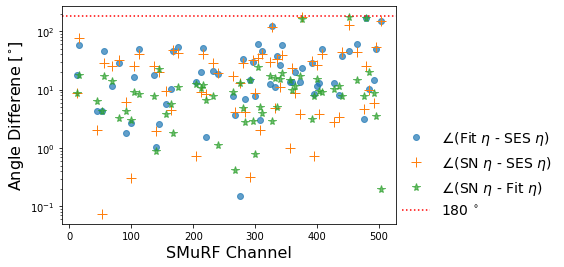

In [195]:
plt.plot(S.which_on(band),np.abs(diff_ang(np.angle(etas_fit,deg=True),etas_ses)),
         'o',alpha = 0.7)
plt.plot(S.which_on(band),np.abs(diff_ang(etas_sn,etas_ses)),'+',
         markersize = 10)
plt.plot(S.which_on(band),np.abs(diff_ang(etas_sn,np.angle(etas_fit,deg=True))),
         '*',markersize = 8,alpha = 0.7)
plt.axhline(180,ls = ':',color = 'red')
plt.yscale('log')
#plt.axhline(-180,ls = ':',color = 'orange')
plt.legend(['$\\angle$(Fit $\\eta$ - SES $\\eta$)',
            '$\\angle$(SN $\\eta$ - SES $\\eta$)',
            '$\\angle$(SN $\\eta$ - Fit $\\eta$)',
            '180 $^{\\circ}$'],
          fontsize = 14,loc = (1,0),frameon = False)
plt.xlabel('SMuRF Channel',fontsize = 16)
plt.ylabel('Angle Differene [$^{\\circ}$]',fontsize = 16)

## Fit Summary Plots

Text(0, 0.5, 'Counts')

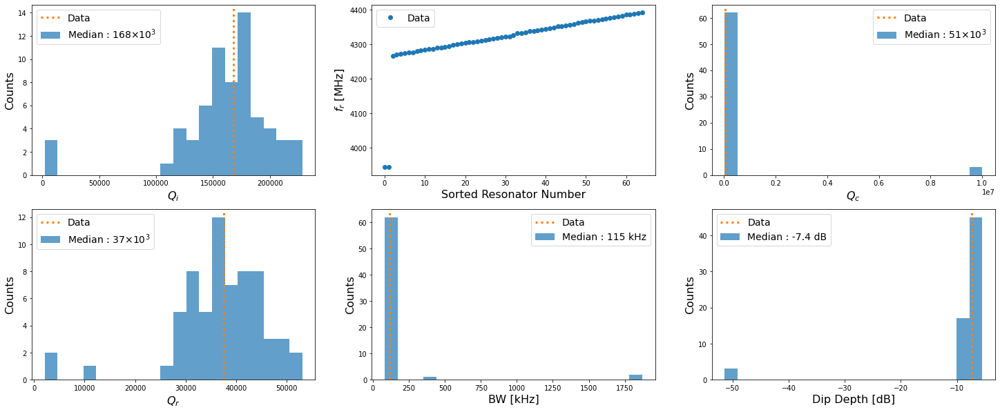

In [196]:
plt.figure(figsize = (25,10))
plt.subplot(2,3,1)
plt.hist(dfout['Qi'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)],bins = 20,alpha = 0.7)
plt.axvline(np.median(dfout['Qi'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]),color = 'C1',ls = ':',lw = 3)
plt.legend(['Data',f'Median : {int(np.median(dfout["Qi"][(dfout["Qi"] < 0.5e6) & (dfout["Qi"] >0)]/1e3))}' + '$\\times10^{3}$'],
          fontsize = 14)
plt.xlabel('$Q_i$',fontsize = 16)
plt.ylabel('Counts',fontsize = 16)

plt.subplot(2,3,2)
plt.plot(np.sort(dfout['f0'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]),'o')
plt.legend(['Data'],fontsize = 14)
plt.xlabel('Sorted Resonator Number',fontsize = 16)
plt.ylabel('$f_r$ [MHz]',fontsize = 16)

plt.subplot(2,3,3)
plt.hist(dfout['Qc'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)],bins = 20,alpha = 0.7)
plt.axvline(np.median(dfout['Qc'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]),color = 'C1',ls = ':',lw = 3)
plt.legend(['Data',f'Median : {int(np.median(dfout["Qc"][(dfout["Qi"] < 0.5e6) & (dfout["Qi"] >0)]/1e3))}' + '$\\times10^{3}$'],
          fontsize = 14)
plt.xlabel('$Q_c$',fontsize = 16)
plt.ylabel('Counts',fontsize = 16)

plt.subplot(2,3,4)
plt.hist(dfout['Q'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)],bins = 20,alpha = 0.7)
plt.axvline(np.median(dfout['Q'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]),color = 'C1',ls = ':',lw = 3)
plt.legend(['Data',f'Median : {int(np.median(dfout["Q"][(dfout["Qi"] < 0.5e6) & (dfout["Qi"] >0)]/1e3))}' + '$\\times10^{3}$'],
          fontsize = 14)
plt.xlabel('$Q_r$',fontsize = 16)
plt.ylabel('Counts',fontsize = 16)

plt.subplot(2,3,5)
plt.hist(2*dfout['br'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]*1e3,bins = 20,alpha = 0.7)
plt.axvline(np.median(2*dfout['br'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]*1e3),color = 'C1',ls = ':',lw = 3)
plt.legend(['Data',f'Median : {int(np.median(2*dfout["br"][(dfout["Qi"] < 0.5e6) & (dfout["Qi"] >0)]*1e3))} kHz'],
          fontsize = 14)
plt.xlabel('BW [kHz]',fontsize = 16)
plt.ylabel('Counts',fontsize = 16)

plt.subplot(2,3,6)
plt.hist(20*np.log10(dfout['depth'][(dfout['Qi'] < 0.5e6) & (dfout['Qi'] >0)]),bins = 20,alpha = 0.7)
plt.axvline(np.median(20*np.log10(dfout['depth'][dfout['Qi'] < 0.5e6])),color = 'C1',ls = ':',lw = 3)
plt.legend(['Data',f'Median : {np.round(np.median(20*np.log10(dfout["depth"][(dfout["Qi"] < 0.5e6) & (dfout["Qi"] >0)])),1)} dB'],
          fontsize = 14)
plt.xlabel('Dip Depth [dB]',fontsize = 16)
plt.ylabel('Counts',fontsize = 16)

Save fits + etas + freqs

In [199]:
dfout.to_pickle('/data/notebooks/scratch/msilvafe/20211013_resonator_fits.pkl')

In [200]:
np.save('/data/notebooks/scratch/msilvafe/20211013_resfit_result_dict',resultdict)

In [202]:
etas_and_freqs = {}
etas_and_freqs['etas_sn_deg'] = etas_sn
etas_and_freqs['etas_ses_deg'] = etas_ses 
etas_and_freqs['etas_fit_deg'] = np.angle(etas_fit,deg=True)
etas_and_freqs['freqs_sn'] = freqs_sn
etas_and_freqs['freqs_ses'] = freqs_ses
etas_and_freqs['freqs_fit'] = [resultdict[k+512*band].best_values['f_0'] for k in chans_on]
etas_and_freqs['chans_on'] = chans_on
np.save('/data/notebooks/scratch/msilvafe/20211013_etas_and_freqs_dict',etas_and_freqs)

# Tracked White Noise
Take a few white noise sweeps and save the datapaths and median noises/channel to a dictionary.

In [203]:
tracked_noises = {}
for ntimes in range(5):
    tracked_noises[ntimes] = {}
    sid = so.take_g3_data(S,10)
    aman = so.load_session(cfg, session_id = sid)
    wls, bm = get_wls_from_am(aman)
    tracked_noises[ntimes]['wls'] = wls
    tracked_noises[ntimes]['median'] = bm
    tracked_noises[ntimes]['sid'] = sid
    tracked_noises[ntimes]['chans'] = aman.ch_info['channel']

100%|██████████| 1/1 [00:00<00:00, 140.02it/s]
/home/cryo/.local/lib/python3.6/site-packages/scipy/signal/spectral.py:1963: UserWarning: nperseg = 65536 is greater than input length  = 2399, using nperseg = 2399
  .format(nperseg, input_length))
/home/cryo/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/cryo/.local/lib/python3.6/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)
100%|██████████| 1/1 [00:00<00:00, 153.76it/s]
/home/cryo/.local/lib/python3.6/site-packages/scipy/signal/spectral.py:1963: UserWarning: nperseg = 65536 is greater than input length  = 2496, using nperseg = 2496
  .format(nperseg, input_length))
100%|██████████| 1/1 [00:00<00:00, 156.32it/s]
/home/cryo/.local/lib/python3.6/site-packages/scipy/signal/spectral.py:1963: UserWarning: nperseg = 65536 is greater than input length  = 2535, using nperseg

Text(0.5, 1.0, '5 x 10 sec Noise TODs')

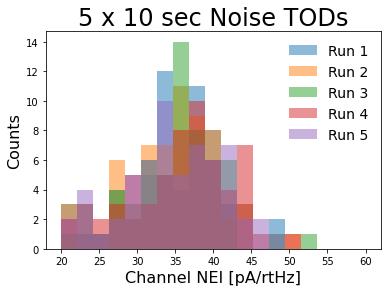

In [204]:
bins = np.linspace(20,60,20)
for key in tracked_noises.keys():
    plt.hist(tracked_noises[key]['wls'][tracked_noises[key]['wls']<60],
             bins = bins,alpha = 0.5)
plt.xlabel('Channel NEI [pA/rtHz]',fontsize = 16)
plt.ylabel('Counts',fontsize = 16)
plt.legend(['Run 1', 'Run 2','Run 3','Run 4', 'Run 5'],
          loc = 'upper right',frameon = False,fontsize = 14)
plt.title('5 x 10 sec Noise TODs',fontsize = 24)

In [205]:
np.save('/data/notebooks/scratch/msilvafe/20210930_tracked_noise',tracked_noises)

## Take Fast Sample Dataset
Take 2.4 MHz data to check that we can convert from the fast sample data to pA/rtHz just using the fitted SQUID curve df/dI. But need to rewrite pysmurf function to make sure that I can pass a fixed eta parameters (i.e. so that it doesn't change them relative to the tracked data).

Changing this function relative to last notebook to:
- Take both I & Q data using rfiq mode
- Take the data w/ eta mag scaled = 1


In [206]:
def take_noise_high_bw_multichan(S, band, channels, freqs=None,eta_mags=None,
                                 eta_phases=None,tone_powers=None, nsamp=2**25, 
                                 nperseg=2**18, make_plot=True,show_plot=False, 
                                 save_plot=True, band_off=True,
                                 run_serial_gradient_descent=True,
                                 run_serial_eta_scan=True, save_psd=False):
    #Freqs from channels
    if freqs is not None:
        S.log('Resonator frequencies provided by user.' +
            ' Ignoring input band and channel.')
    else:
        freqs = []
        for channel in channels:
            freqs.append(S.channel_to_freq(band, channel))  # resonance frequency
            S.log('Loading band/channel pair. Resonator frequency' +
                f' {freq:4.3} MHz')
    S.log(f'Frequencies used: {freqs}')
    
    #Define high bw sample rate
    channel_freq = S.get_channel_frequency_mhz(band) * 1.0E6
        
    #Eta mags
    if eta_mags is not None:
        S.log('Resonator eta mags provided by user.' +
              ' Ignoring input band and channel.')
    else:
        eta_mags = []
        for channel in channels:
            eta_mags.append(S.get_eta_mag_scaled_channel(band, channel))
    
    #Eta phases
    if eta_phases is not None:
        S.log('Resonator eta phases provided by user.' +
              ' Ignoring input band and channel.')
    else:
        eta_phases = []
        for channel in channels:
            eta_phases.append(S.get_eta_phase_degree_channel(band, channel))
            
    #Tone powers:
    if tone_powers is None:
        tone_powers = []
        for i,channel in enumerate(channels):
            tone_powers.append(S.get_amplitude_scale_channel(band, channel))
            if tone_powers[i] == 0:
                S.log("Tone amplitude is set to zero. Using default of 12")
                tone_powers[i] = 12
                 
    # Turn off feedback and FR
    S.set_feedback_enable(band, 0)
    S.flux_ramp_off()
    
    #Loop over Frequencies
    outdict = {}
    for i, freq in enumerate(freqs):
        outdict[freq] = {}
        if band_off:
            S.band_off(band)

        # Turn on single tone
        band, channel = S.set_fixed_tone(freq, tone_powers[i])

        # Run optimization
        if run_serial_gradient_descent:
            S.run_serial_gradient_descent(band)
        if run_serial_eta_scan:
            S.run_serial_eta_scan(band)
            eta_phase = S.get_eta_phase_degree_channel(band, channel)
            eta_mag = S.get_eta_mag_scaled_channel(band, channel)
        
        if ~run_serial_eta_scan:
            eta_phase = eta_phases[i]
            eta_mag = eta_mags[i]

        # Take I/Q data
        timestamp = S.get_timestamp()
        filename = f'{timestamp}_single_channel_b{band}ch{channel:03}'
        i2,q,sync = S.take_debug_data(band=band,channel=channel,
                                     rf_iq=True,nsamp=nsamp,
                                     filename = filename)
        eta_phase_rad = np.deg2rad(eta_phase)
        I = np.cos(eta_phase_rad) * i2 - np.sin(eta_phase_rad) * q
        Q = np.sin(eta_phase_rad) * i2 + np.cos(eta_phase_rad) * q

        ffi,pxxi = welch(I,fs=channel_freq,nperseg=nperseg)
        ffq,pxxq = welch(Q,fs=channel_freq,nperseg=nperseg)

        # scale to dBc/Hz by the voltage magnitude
        magfac = np.mean(q)**2 + np.mean(i)**2
        pxxi_dbc = 10. * np.log10(pxxi / magfac)
        pxxq_dbc = 10. * np.log10(pxxq / magfac)
        
        if make_plot:
            fig, ax = plt.subplots(2, figsize=(6,5.5),
                gridspec_kw={'height_ratios': [1, 2]})
            t_ms = np.arange(nperseg)/channel_freq * 1.0E3 # Time in ms
            ax[0].plot(t_ms, Q[:nperseg],alpha = 0.5)  # Plot only the first nperseg samples
            ax[0].plot(t_ms, I[:nperseg],alpha = 0.5) 
            ax[0].set_xlabel(r'Time [ms]')
            ax[1].loglog(ffq, np.sqrt(pxxq),'C0',alpha = 0.5)
            ax[1].loglog(ffi, np.sqrt(pxxi),'C1',alpha = 0.5)
            ax3 = ax[1].twinx()
            ax3.semilogx(ffq, np.sqrt(pxxq_dbc),'C0',alpha = 0.5)
            ax3.semilogx(ffi, np.sqrt(pxxi_dbc),'C1',alpha = 0.5)            
            ax[1].set_xlabel("Freq [Hz]")
            ax[1].set_ylabel("Amp [FBU/rtHz]")
            ax[1].legend(['Q', 'I'],fontsize = 16,loc = 'lower left')

            text = f'Res {freq:4.2f} MHz' + '\n' +\
                   r'$\eta_{mag}$ ' + f'{1.00:2.3f}' + '\n' +\
                   r'$\eta_{phase}$ ' + f'{eta_phase:2.1f} deg' + '\n' + \
                   f'Tone {tone_powers[i]}'
            ax[1].text(.02, .98, text, transform=ax[1].transAxes, va='top',
                ha='left')

            ax[1].text(.98, .981, f'Acq Time {nsamp/channel_freq:3.2f} s',
                transform=ax[1].transAxes, va='top', ha='right')


            ax[0].set_title(f'{timestamp} Single Channel Noise b{band}ch{channel:03}')

            plt.tight_layout()

            if save_plot:
                plt.savefig(os.path.join(S.plot_dir, f'{filename}.png'),
                    bbox_inches='tight')
            if show_plot:
                plt.show()
            else:
                plt.close()
        outdict[freq]['timestamp'] = timestamp
        outdict[freq]['filename'] = filename
        if save_psd:
            np.save(os.path.join(S.output_dir, f'{filename}'), ff)
            np.save(os.path.join(S.output_dir, f'{filename}'), pxx)
        outdict[freq]['ffI'] = ffi
        outdict[freq]['pxxI'] = pxxi
        outdict[freq]['I'] = I
        outdict[freq]['ffQ'] = ffq
        outdict[freq]['pxxQ'] = pxxq
        outdict[freq]['Q'] = Q
    return outdict

In [208]:
freqs_to_study = [S.channel_to_freq(band,ch) for ch in chans_on]
# eta_mags = [S.get_eta_mag_scaled_channel(band,ch) for ch in smurf_chans_to_study]
# eta_phases = [S.get_eta_phase_degree_channel(band,ch) for ch in smurf_chans_to_study]
eta_mags = [1 for ch in chans_on]
eta_phases = [0 for ch in chans_on]

In [210]:
high_bw_data = take_noise_high_bw_multichan(S, band=band, channels=chans_on, 
                                            freqs=freqs_to_study,eta_mags=eta_mags,
                                            eta_phases=eta_phases, tone_powers=None, nsamp=2**25, 
                                            nperseg=2**18, make_plot=True,show_plot=False, 
                                            save_plot=True, band_off=True, run_serial_gradient_descent=False,
                                            run_serial_eta_scan=False, save_psd=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:104: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:104: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:104: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:103: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:104: RuntimeWarning: invalid value encountered in sqrt
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:103: Runtim

In [213]:
np.save('/data/notebooks/scratch/msilvafe/20211013_high_bw_data_all',high_bw_data)

# Checking $\eta$ rotation 

In [211]:
hbw_keys = np.fromiter(high_bw_data.keys(),dtype = 'float')

100%|██████████| 62/62 [01:39<00:00,  1.61s/it]


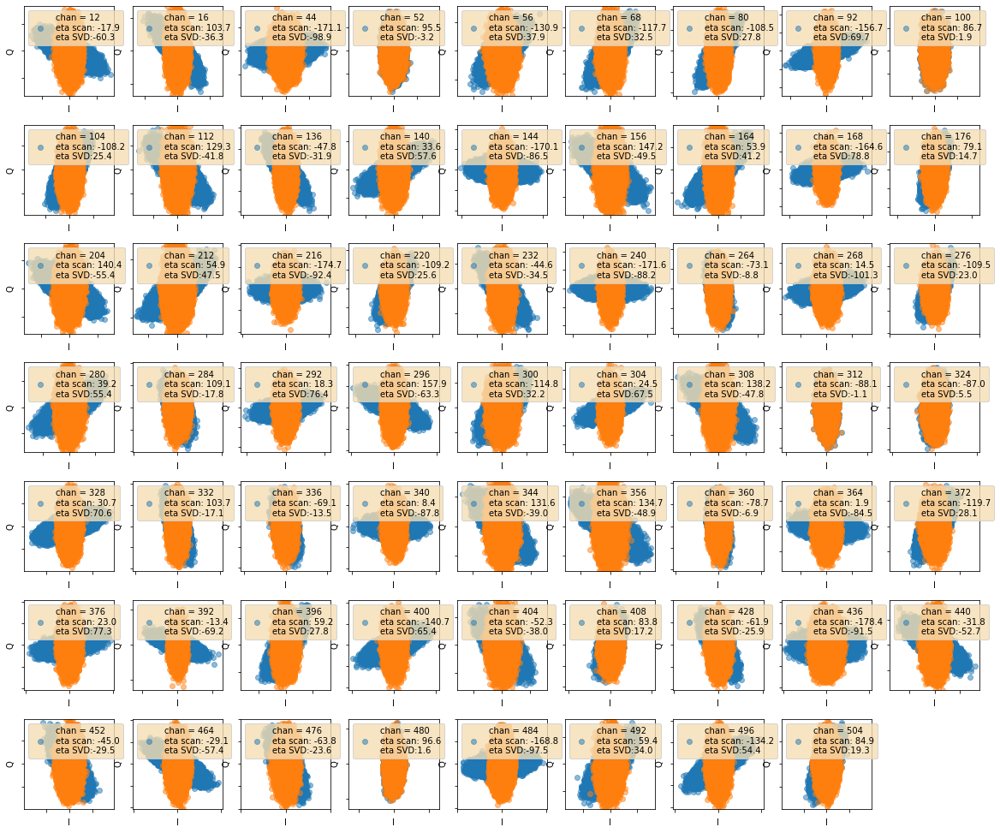

In [212]:
plt.figure(figsize = (20,20))
nplt = 1
etas_svds = {}
for i, key in tqdm(list(enumerate(high_bw_data.keys()))):
    plt.subplot(8,9,nplt)
    Is = high_bw_data[key]['I'][:2**18]-np.mean(high_bw_data[key]['I'][:2**18])
    Qs = high_bw_data[key]['Q'][:2**18]-np.mean(high_bw_data[key]['Q'][:2**18])
    
    SVD_array = np.asarray([Qs[:2**13], Is[:2**13]])
    U, s, Vh = np.linalg.svd(SVD_array)
    ang = np.angle(U[1,0] + 1.j*U[1,1], deg=True) - 90
    ang_rad = np.deg2rad(ang)
    etas_svds[i] = ang
    
    Irot = np.cos(ang_rad)*high_bw_data[key]['I'][:2**18] - np.sin(ang_rad)*high_bw_data[key]['Q'][:2**18]
    Qrot = np.sin(ang_rad)*high_bw_data[key]['I'][:2**18] + np.cos(ang_rad)*high_bw_data[key]['Q'][:2**18]
    Irot -= np.mean(Irot)
    Qrot -= np.mean(Qrot)
    
    plt.plot(Is,Qs,'o',alpha = 0.5)
    plt.plot(Irot,Qrot,'o',alpha = 0.5)
    maxtot = max(np.max(np.abs(Is)),np.max(np.abs(Qs)))
    plt.xlim(-1.1*maxtot,1.1*maxtot)
    plt.ylim(-1.1*maxtot,1.1*maxtot)
    plt.xlabel('I')
    plt.ylabel('Q')
    plt.legend([f'chan = {int(chans_on[i])}\neta scan: {np.round(etas_ses[i],1)}\neta SVD:{np.round(ang,1)}'],
               loc = 'upper left',facecolor='wheat')
    ax = plt.gca()
    ax.axes.xaxis.set_ticklabels([])
    ax.axes.yaxis.set_ticklabels([])
    ax.set_aspect('equal', adjustable='box')
    nplt+=1

100%|██████████| 62/62 [07:18<00:00,  7.08s/it]


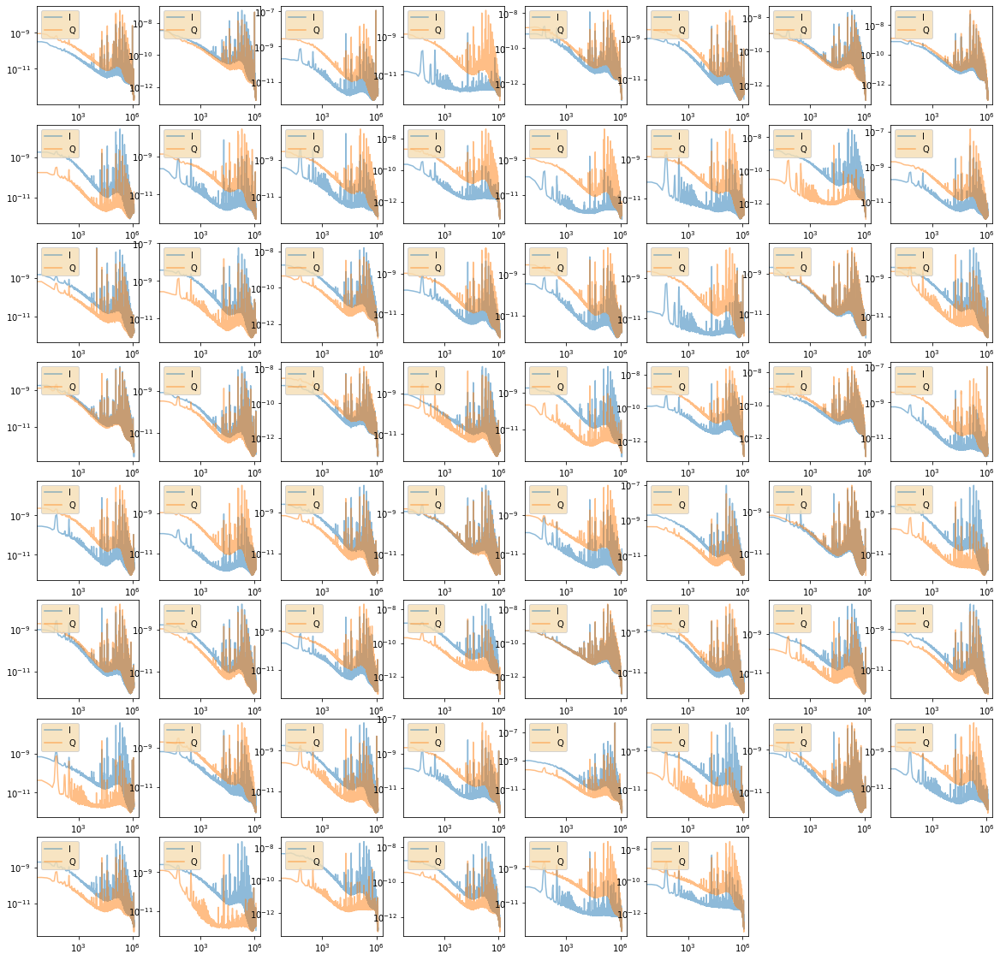

In [227]:
plt.figure(figsize = (20,20))
nplt = 1
channel_freq = S.get_channel_frequency_mhz(band) * 1.0E6
nperseg = 2**18
for i, key in tqdm(list(enumerate(high_bw_data.keys()))):
    plt.subplot(8,8,nplt)
    
    Irot = np.cos(etas_svds[i])*high_bw_data[key]['I'] - np.sin(etas_svds[i])*high_bw_data[key]['Q']
    Qrot = np.sin(etas_svds[i])*high_bw_data[key]['I'] + np.cos(etas_svds[i])*high_bw_data[key]['Q']
    Irot -= np.mean(Irot)
    Qrot -= np.mean(Qrot)
    
    ffi,pxxi = welch(Irot,fs=channel_freq,nperseg=nperseg)
    ffq,pxxq = welch(Qrot,fs=channel_freq,nperseg=nperseg)
    plt.loglog(ffi,pxxi,alpha = 0.5)
    plt.loglog(ffq,pxxq,alpha = 0.5)

    plt.legend(['I','Q'],
               loc = 'upper left',facecolor='wheat')
    nplt+=1

## Compare $\eta$'s

Text(0, 0.5, 'Angle Differene [$^{\\circ}$]')

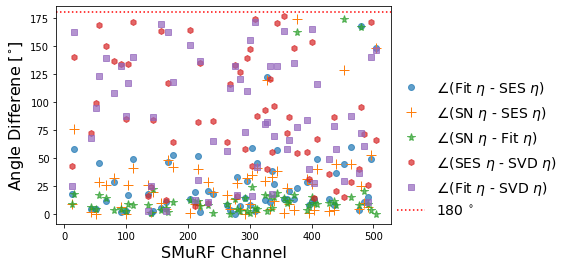

In [230]:
etas_svd = [etas_svds[i] for i in range(len(chans_on))]
plt.plot(chans_on,np.abs(diff_ang(np.angle(etas_fit,deg=True),etas_ses)),
         'o',alpha = 0.7)
plt.plot(chans_on,np.abs(diff_ang(etas_sn,etas_ses)),'+',
         markersize = 10)
plt.plot(chans_on,np.abs(diff_ang(etas_sn,np.angle(etas_fit,deg=True))),
         '*',markersize = 8,alpha = 0.7)
plt.plot(chans_on,np.abs(diff_ang(etas_ses,etas_svd)),
         'h',markersize = 6,alpha = 0.7)
plt.plot(chans_on,np.abs(diff_ang(np.angle(etas_fit,deg=True),etas_svd)),
         's',markersize = 6,alpha = 0.7)
plt.axhline(180,ls = ':',color = 'red')
#plt.yscale('log')
#plt.axhline(-180,ls = ':',color = 'orange')
plt.legend(['$\\angle$(Fit $\\eta$ - SES $\\eta$)',
            '$\\angle$(SN $\\eta$ - SES $\\eta$)',
            '$\\angle$(SN $\\eta$ - Fit $\\eta$)',
            '$\\angle$(SES $\\eta$ - SVD $\\eta$)',
            '$\\angle$(Fit $\\eta$ - SVD $\\eta$)',
            '180 $^{\\circ}$'],
          fontsize = 14,loc = (1,0),frameon = False)
plt.xlabel('SMuRF Channel',fontsize = 16)
plt.ylabel('Angle Differene [$^{\\circ}$]',fontsize = 16)

# Plot Circles Rotated w/ SVD

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


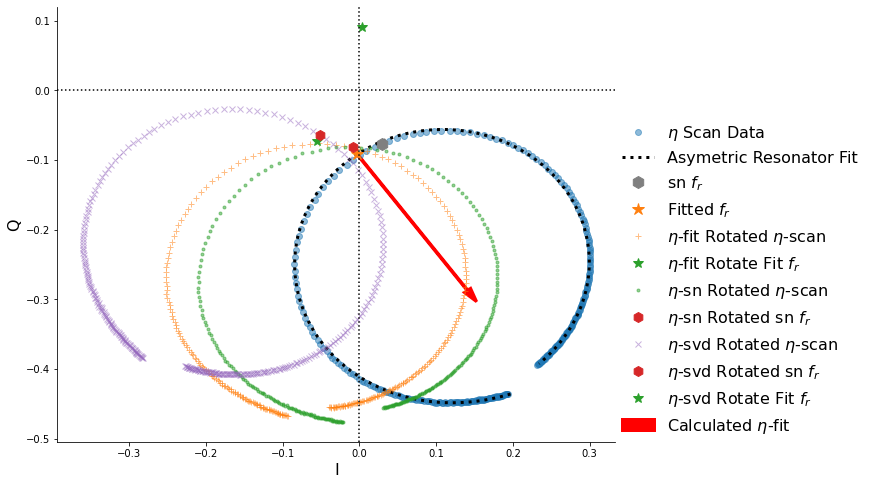

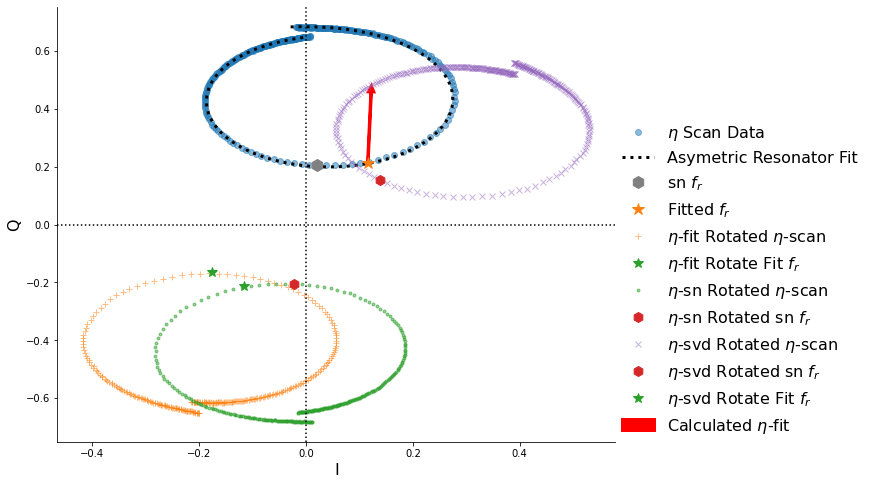

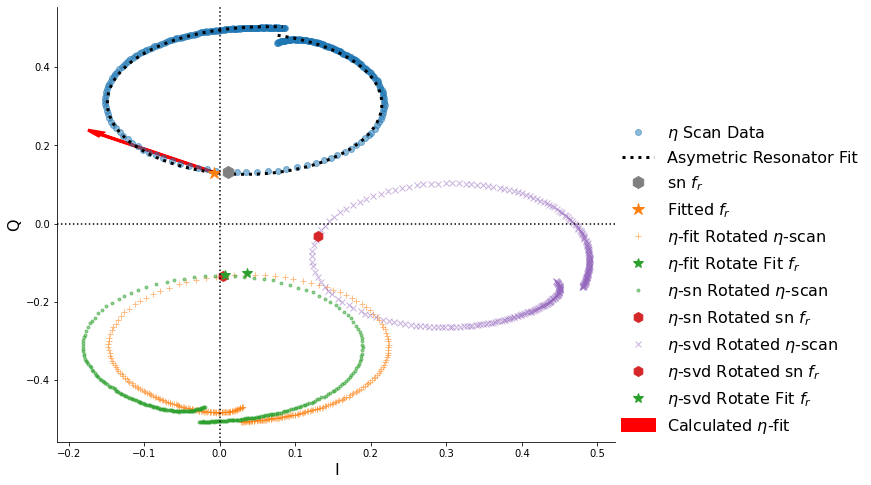

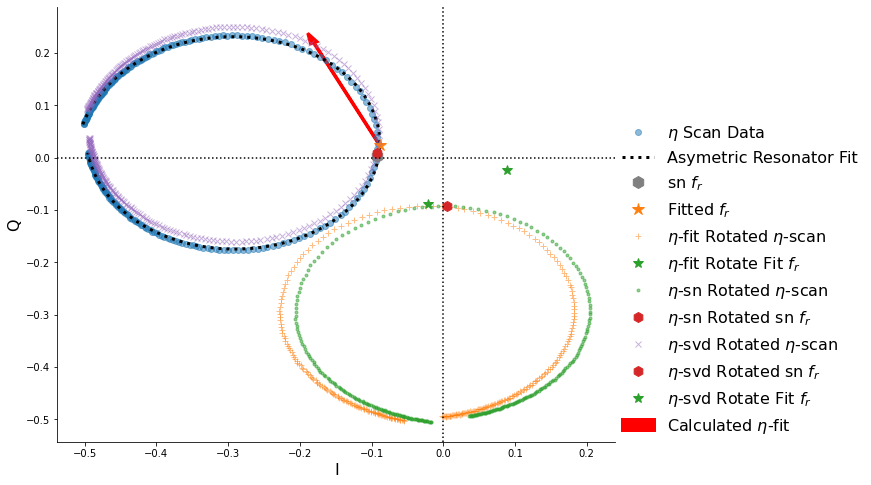

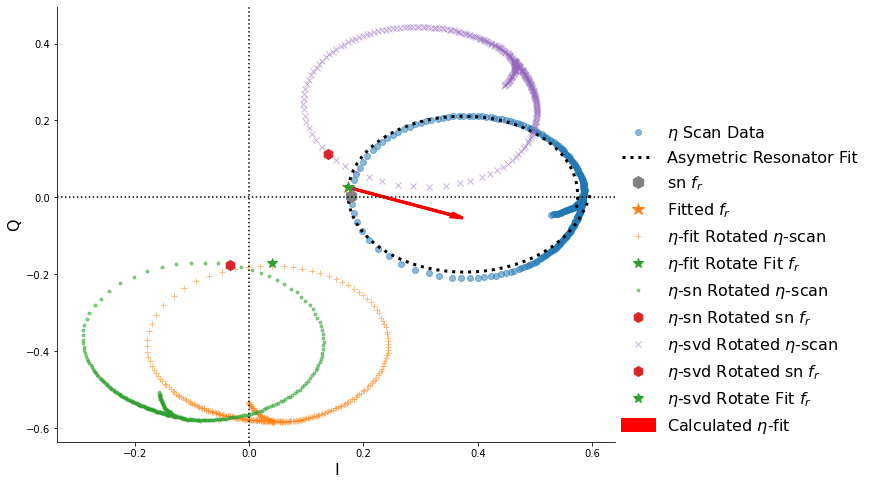

...

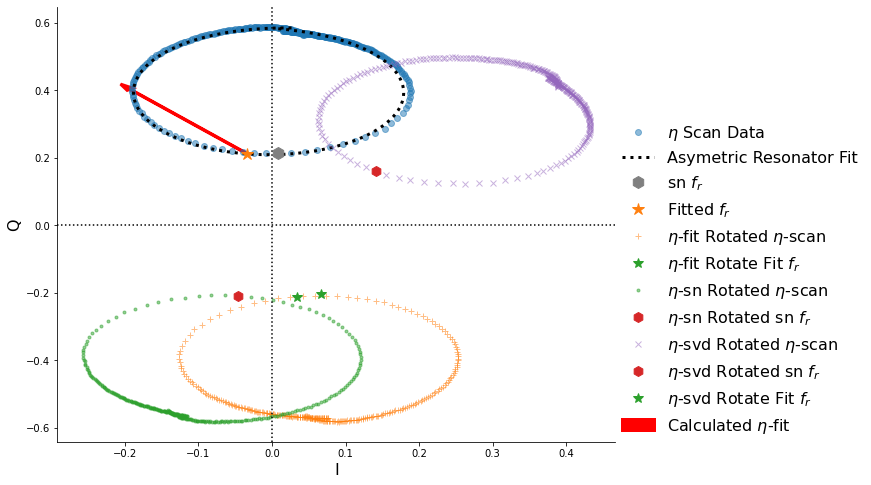

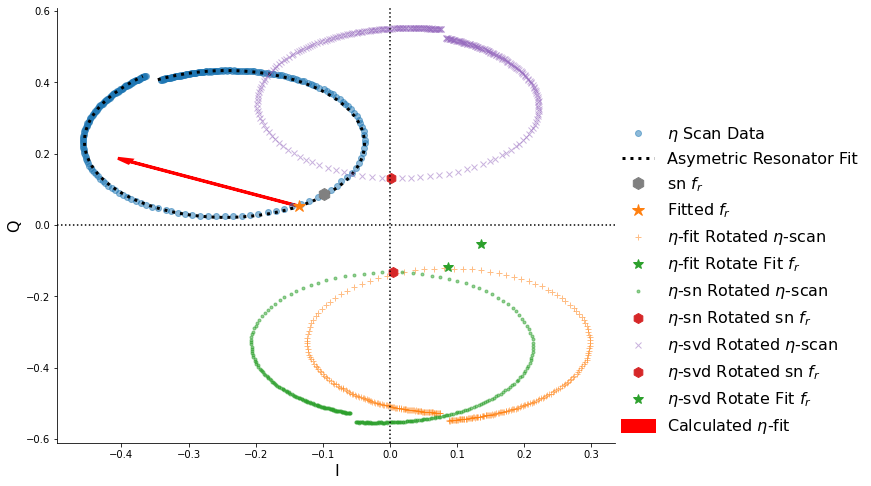

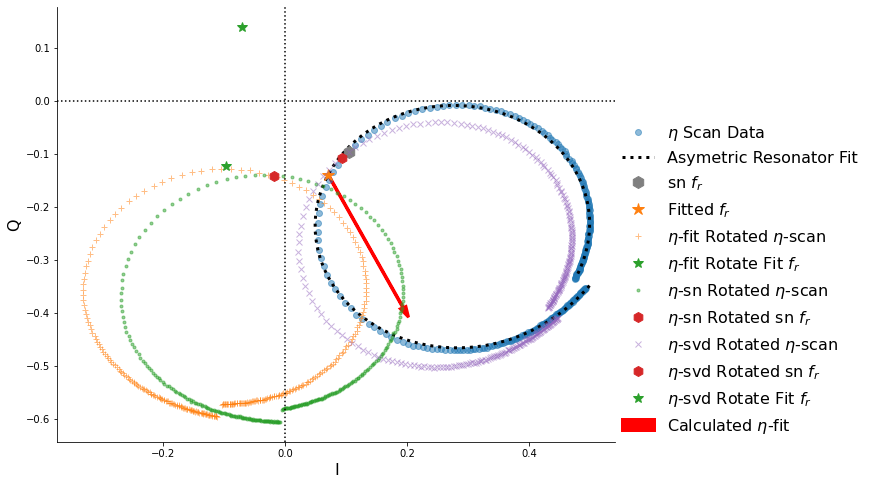

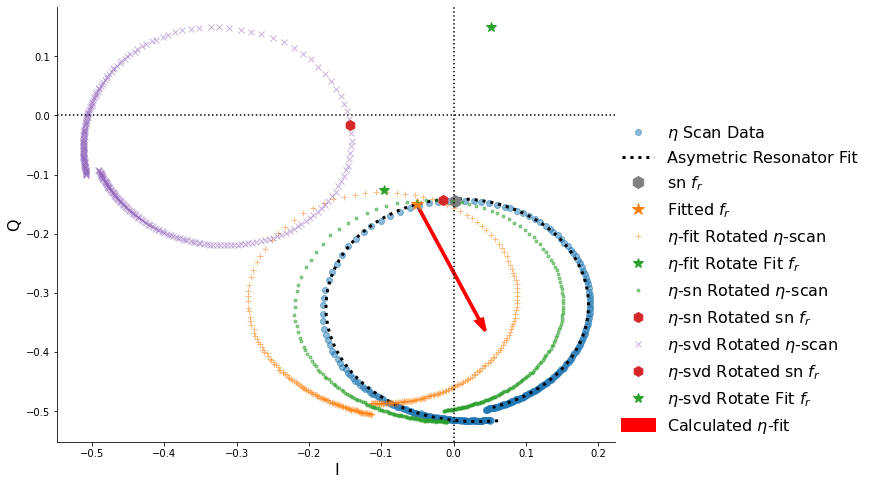

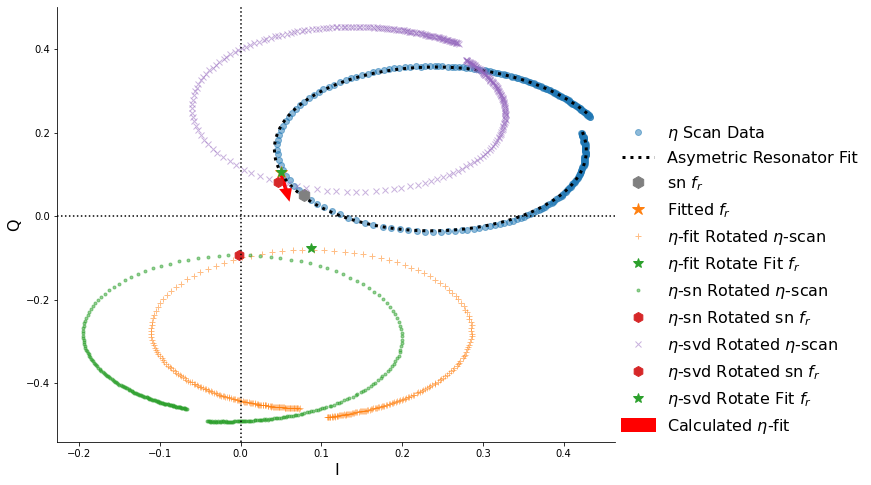

<Figure size 720x576 with 0 Axes>

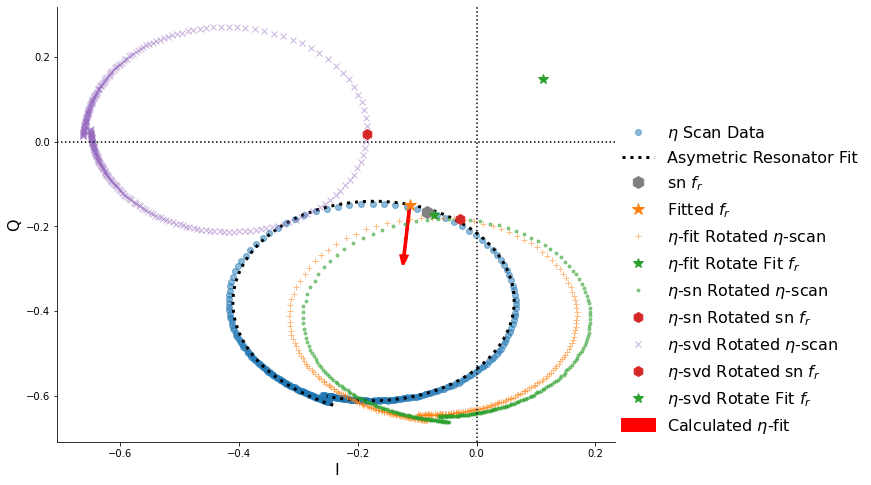

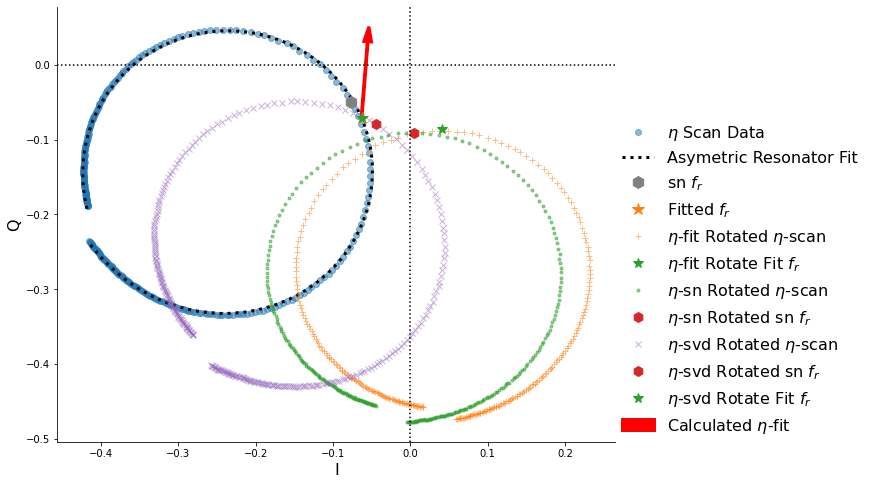

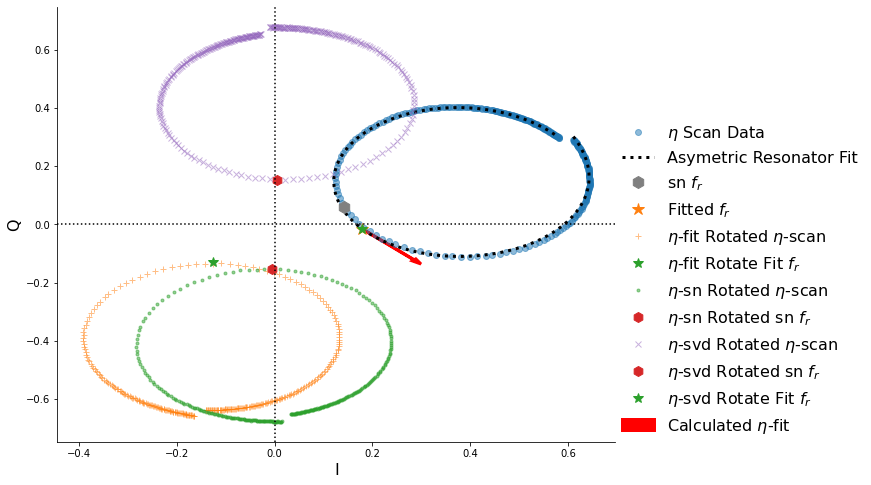

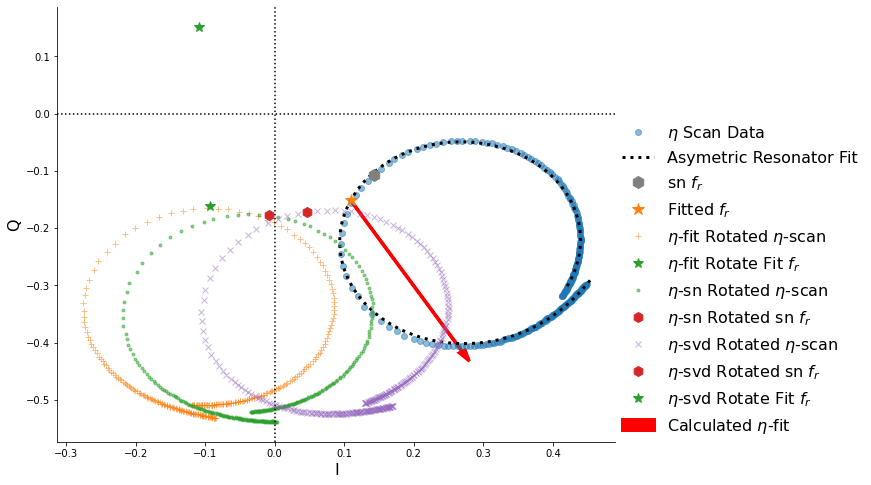

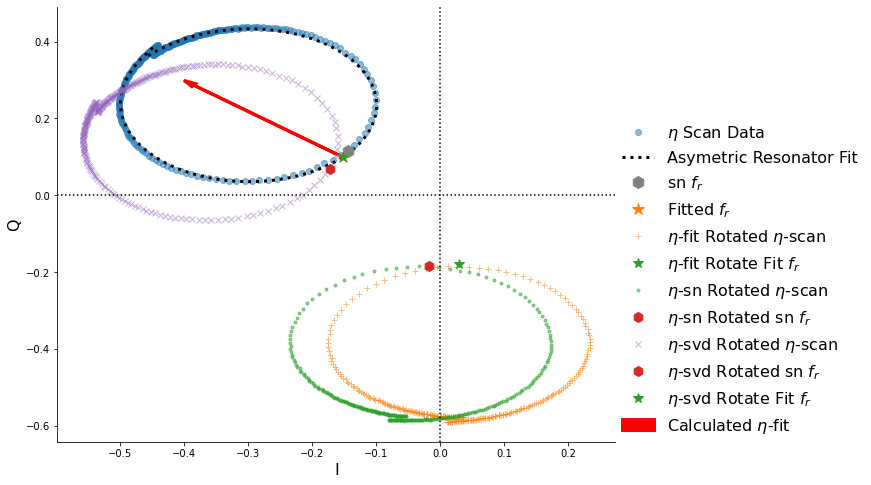

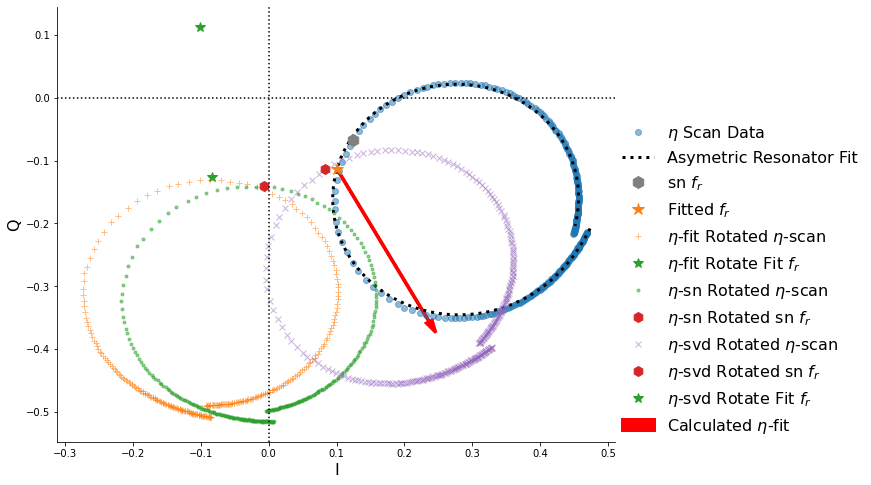

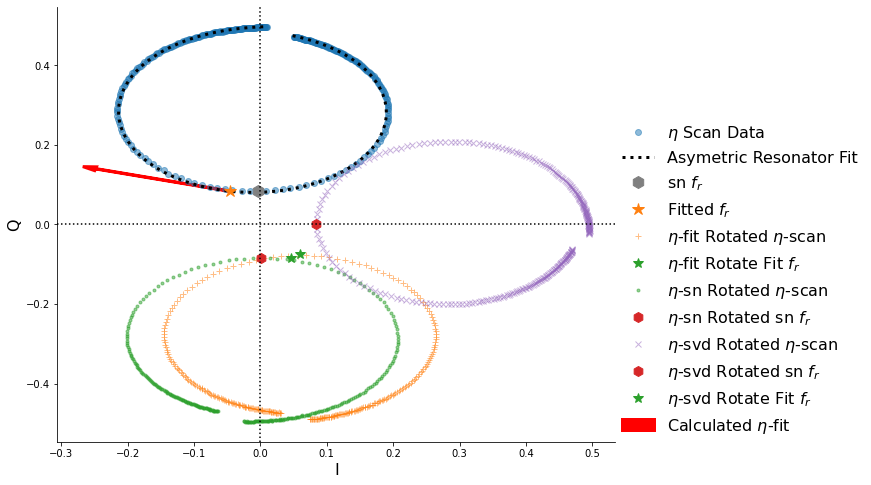

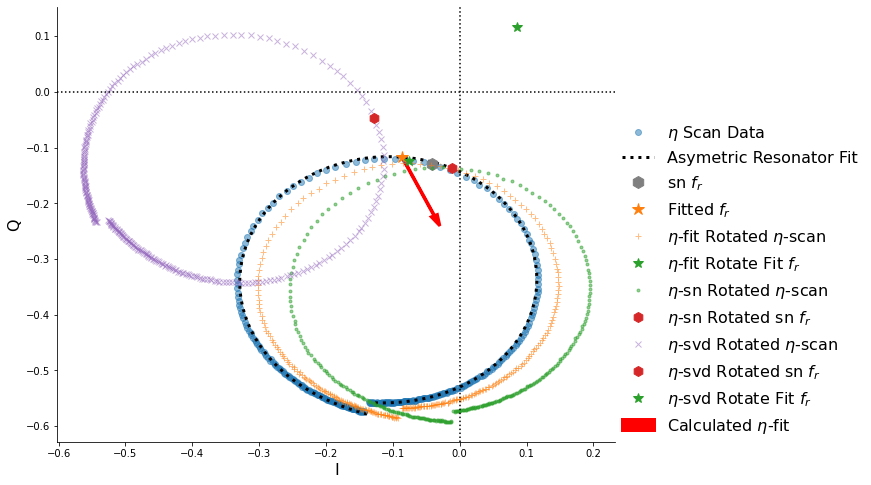

<Figure size 720x576 with 0 Axes>

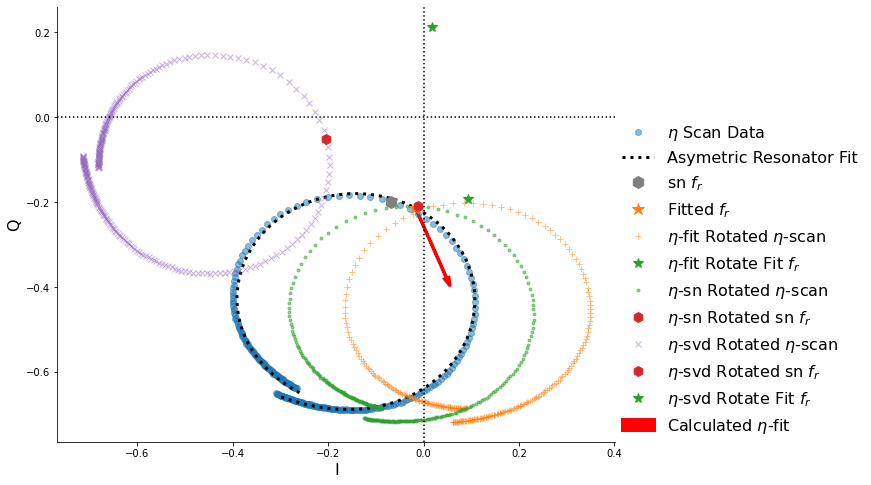

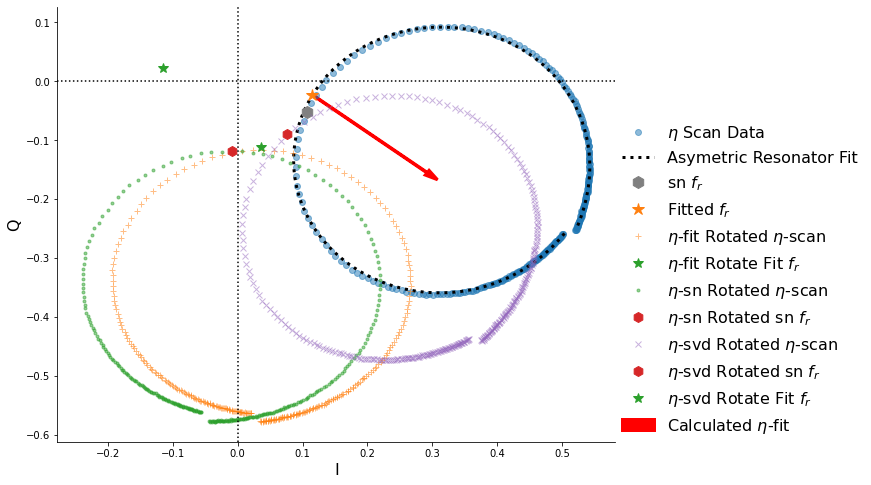

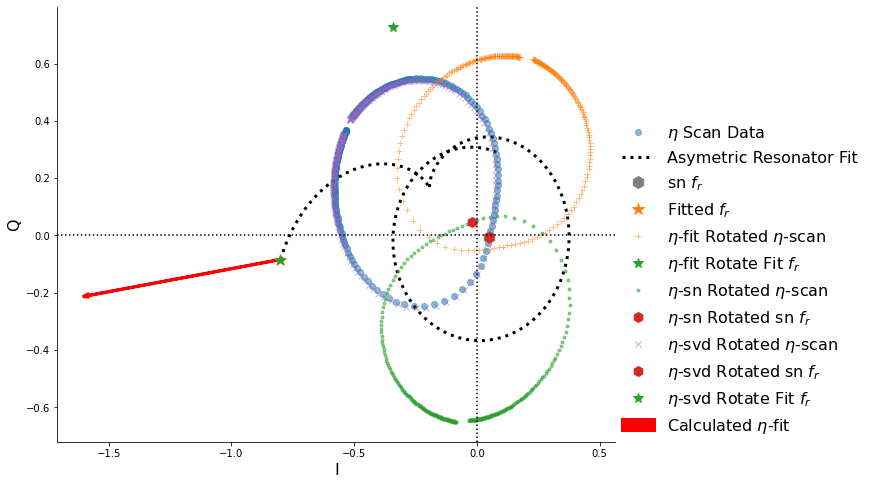

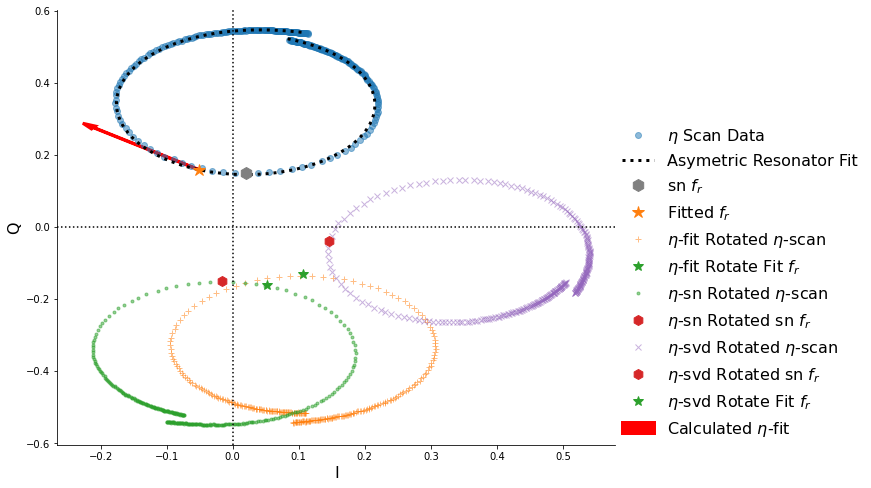

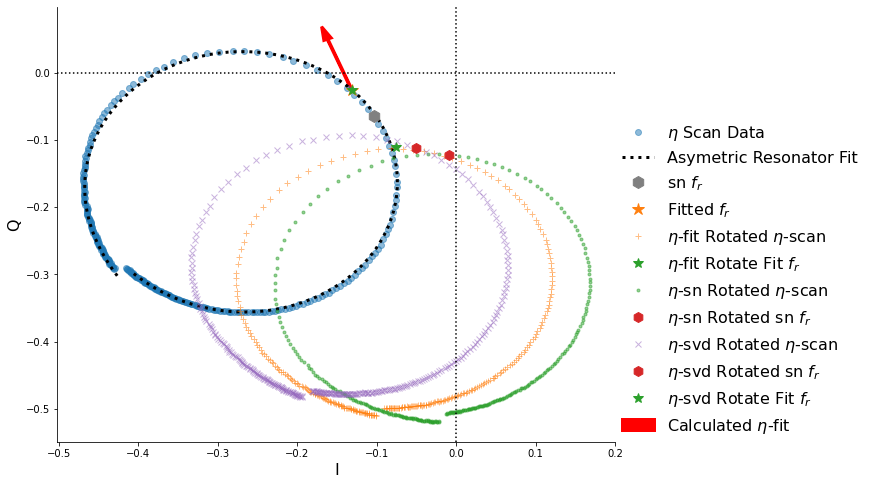

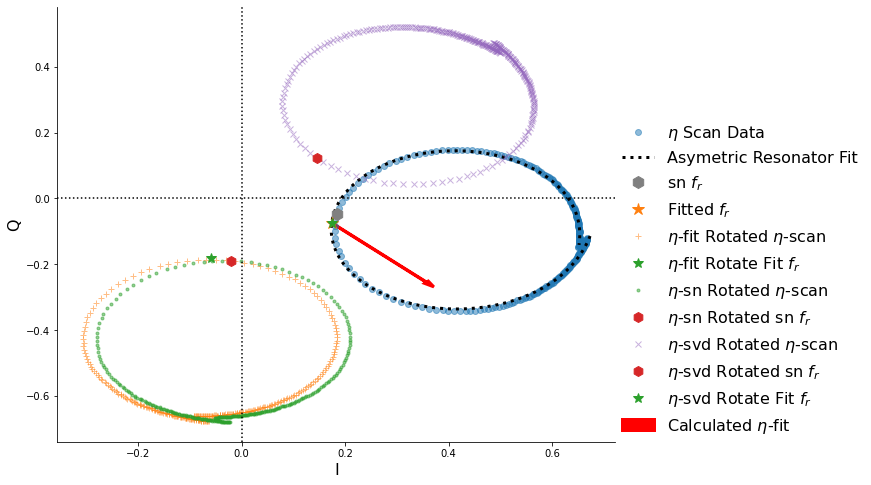

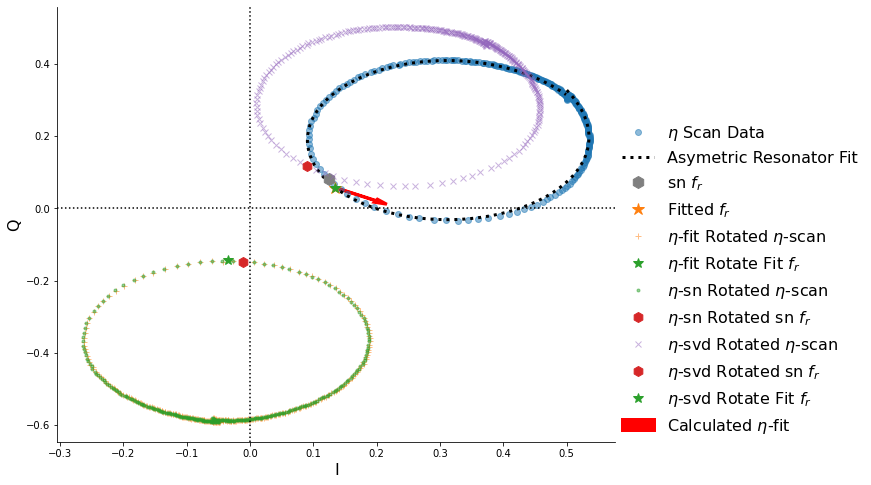

In [236]:
tunedict = np.load(S.tune_file,allow_pickle=True).item()
chan_sn = np.asarray([tunedict[band]['resonances'][key]['channel'] for key in tunedict[band]['resonances'].keys()])
for ix, k in enumerate(chans_on):
    plt.figure(figsize = (10,8))
    snch = np.where(chan_sn == k)[0][0]
    fpl = tunedict[band]['resonances'][snch]['freq_eta_scan']
    rpl = tunedict[band]['resonances'][snch]['resp_eta_scan']
    if np.ptp(20*np.log10(np.abs(rpl))) < 1:
        continue
    fidx = np.argmin(np.abs(fpl-tunedict[band]['resonances'][snch]['freq']))
    plt.plot(np.real(rpl),np.imag(rpl),'o',
             label = '$\\eta$ Scan Data',alpha = 0.5)
    plt.plot(np.real(resultdict[k+512*band].best_fit),np.imag(resultdict[k+512*band].best_fit),
             'k:',label = 'Asymetric Resonator Fit',lw = 3)
    rdc = resultdict[k+512*band].best_values
    minfit = resonator_cable(resultdict[k+512*band].best_values['f_0'],**rdc)
    minsn = rpl[fidx]
    plt.plot(np.real(minsn),np.imag(minsn),
         'h',color ='grey',markersize=12,label = 'sn $f_r$')
    plt.plot(np.real(minfit),np.imag(minfit),
         '*',color ='C1',label = 'Fitted $f_r$',
         markersize=12)
    b = fr_deriv(**rdc)
    arr = minfit + 1/b
    ax = plt.gca()
    plt.arrow(np.real(minfit),np.imag(minfit),
             np.real(arr),np.imag(arr),
             head_width = 0.01, head_length = 0.02,
             fc = 'red',ec = 'red',lw = 3,label = 'Calculated $\\eta$-fit')
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    rpl_rot_i, rpl_rot_q = rot_compl(rpl,etas_fit[ix])
    minstar_i, minstar_q = rot_compl(np.real(minfit) + 1j*np.imag(minfit),etas_fit[ix])
    
    rpl_snrot_i,rpl_snrot_q = rot_compl(rpl,tunedict[band]["resonances"][snch]["eta"])
    minhex_i,minhex_q = rot_compl(minsn,tunedict[band]["resonances"][snch]["eta"])
    
    rpl_svdrot_i, rpl_svdrot_q = rot_compl(rpl,etas_svd[ix],angle=True)
    minstarsvd_i, minstarsvd_q = rot_compl(np.real(minfit) + 1j*np.imag(minfit),etas_svd[ix])
    minhexsvd_i,minhexsvd_q = rot_compl(minsn,etas_svd[ix],angle=True)
    
    plt.plot(rpl_rot_i,rpl_rot_q,'C1+',alpha = 0.5,label = '$\\eta$-fit Rotated $\\eta$-scan')
    plt.plot(minstar_i,minstar_q,'C2*',markersize=10,label = '$\\eta$-fit Rotate Fit $f_r$')
    
    plt.plot(rpl_snrot_i,rpl_snrot_q,'C2.',alpha = 0.5,label = '$\\eta$-sn Rotated $\\eta$-scan')
    plt.plot(minhex_i,minhex_q,'C3h',markersize=10,label = '$\\eta$-sn Rotated sn $f_r$')
    
    plt.plot(rpl_svdrot_i,rpl_svdrot_q,'C4x',alpha = 0.5,label = '$\\eta$-svd Rotated $\\eta$-scan')
    plt.plot(minhexsvd_i,minhexsvd_q,'C3h',markersize=10,label = '$\\eta$-svd Rotated sn $f_r$')
    plt.plot(minstarsvd_i,minstarsvd_q,'C2*',markersize=10,label = '$\\eta$-svd Rotate Fit $f_r$')
    
    plt.axhline(0.0,ls = ':', color = 'k')
    plt.axvline(0.0,ls = ':', color = 'k')

    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.xlabel('I',fontsize = 16)
    plt.ylabel('Q',fontsize = 16)
    plt.legend(fontsize = 16,
                loc = (1.0,0),frameon=False)


# Plot $\eta$-Scan Derivatives

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


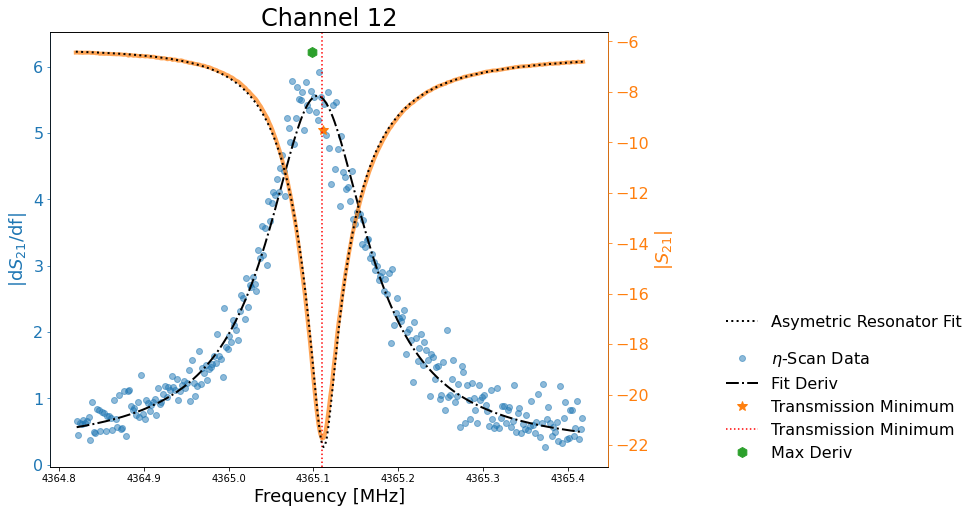

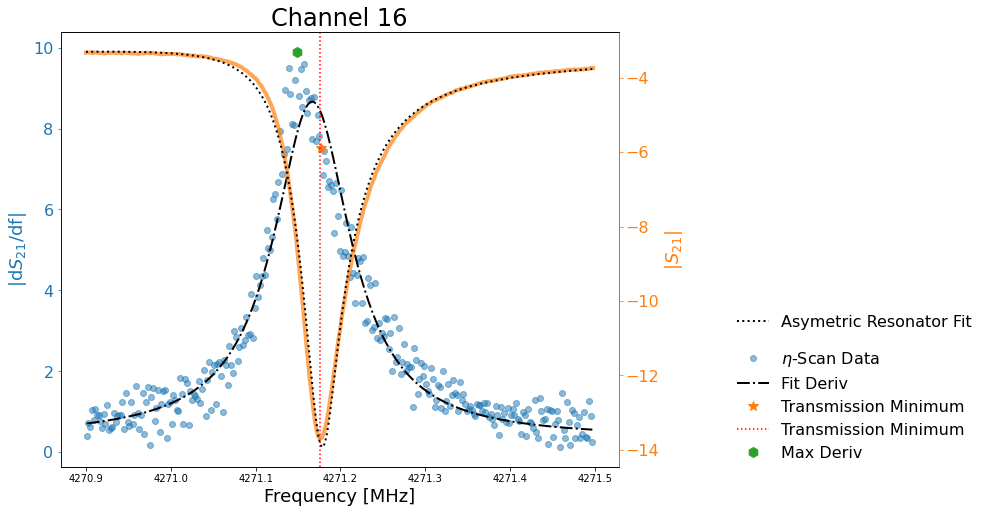

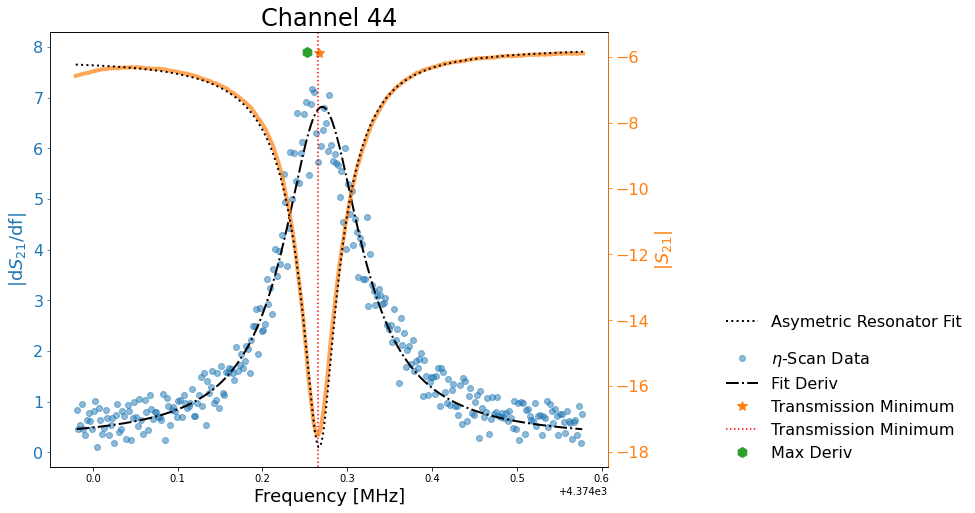

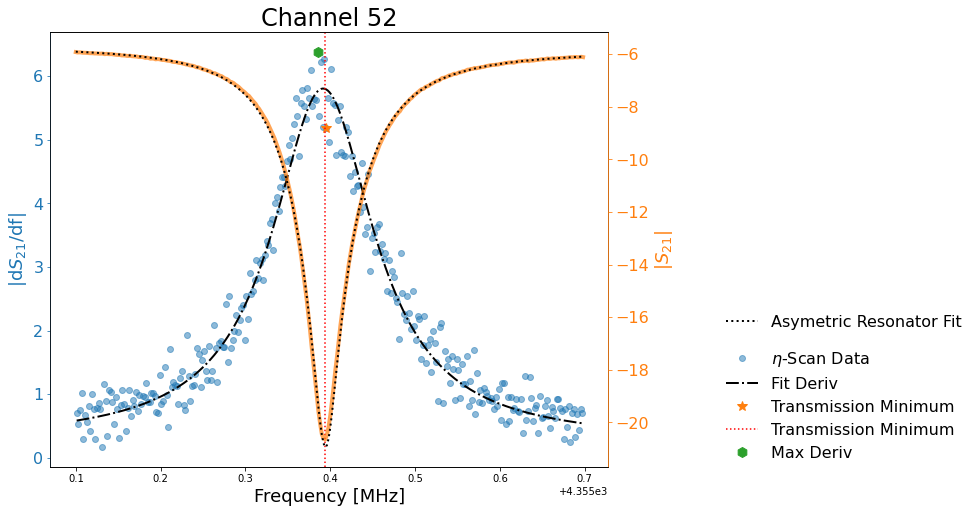

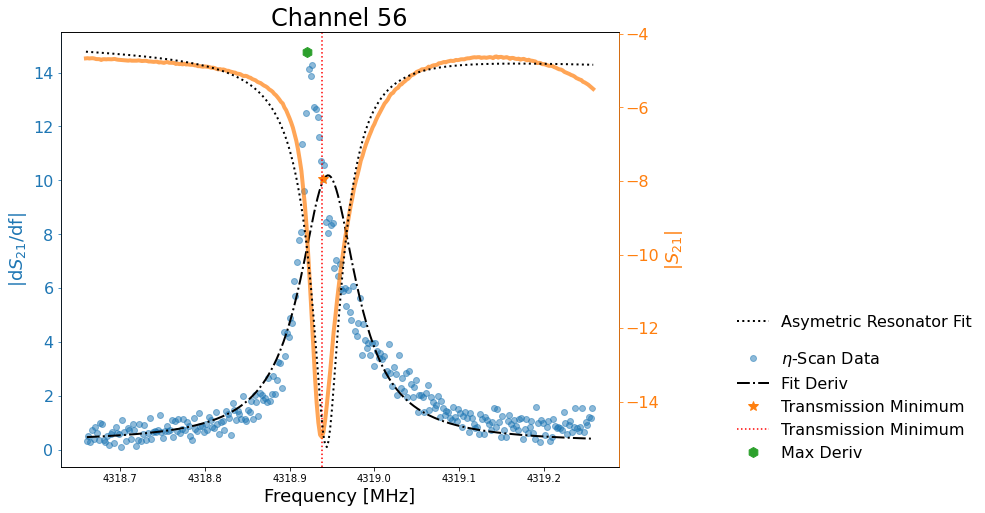

...

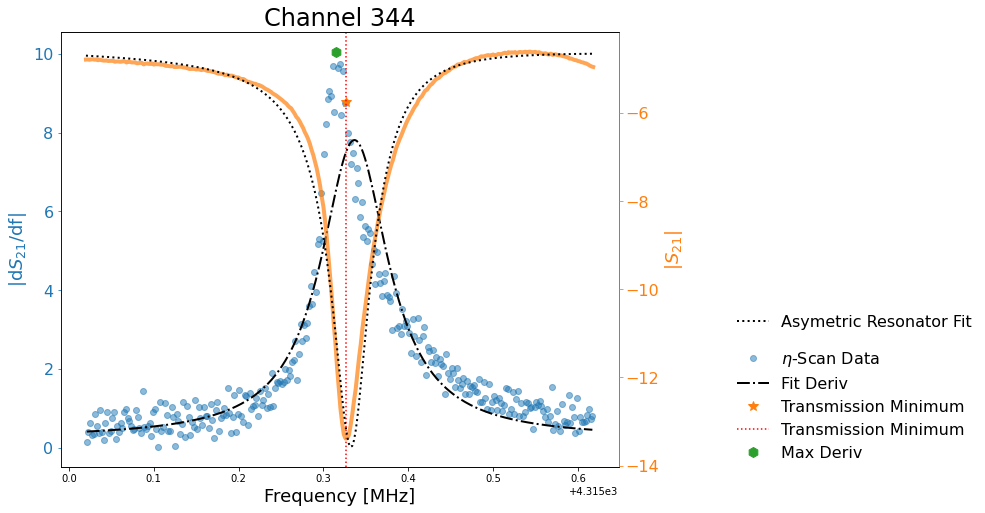

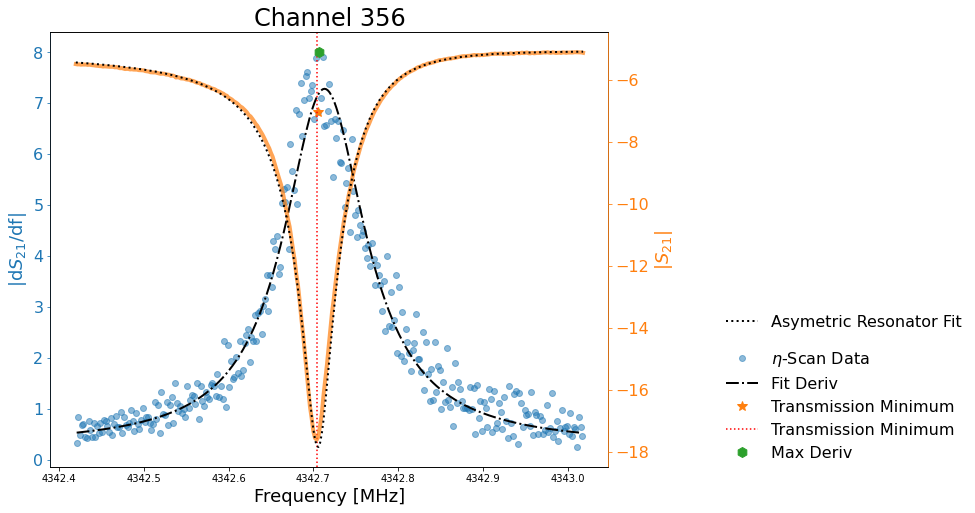

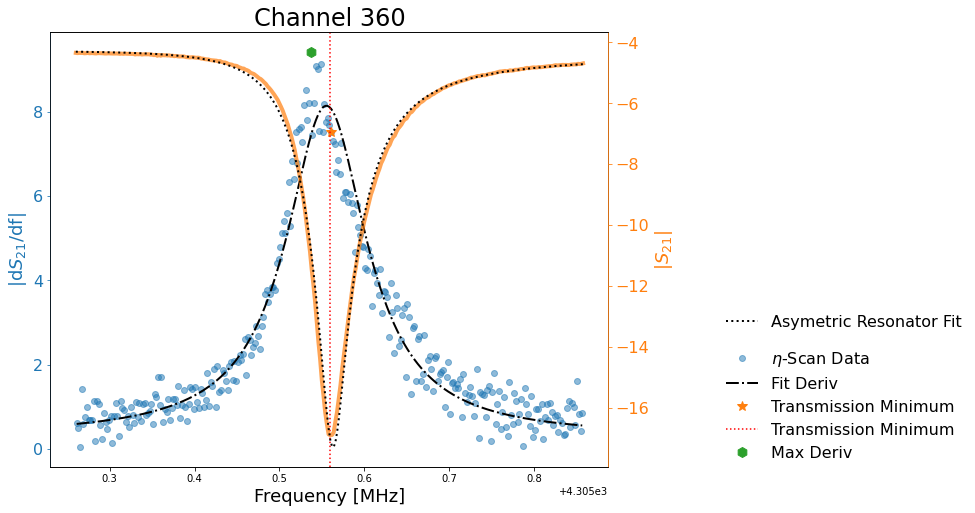

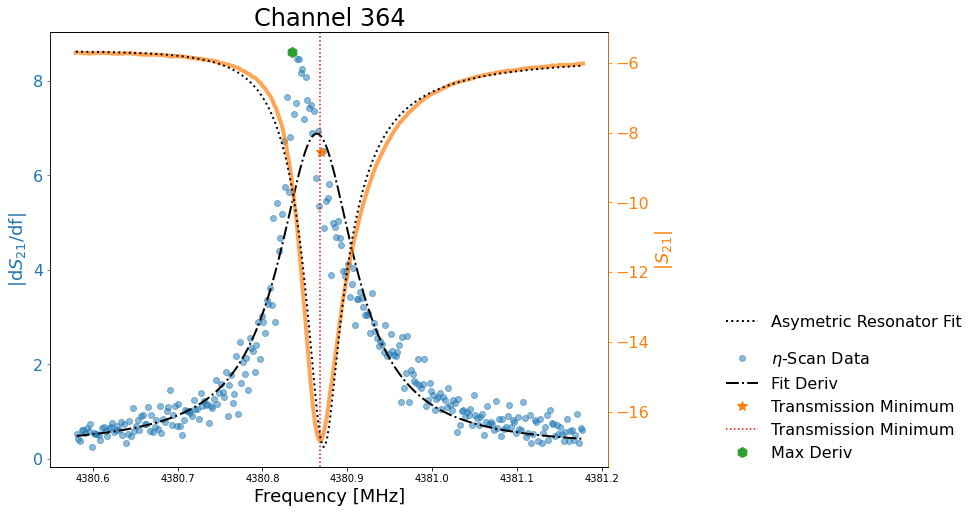

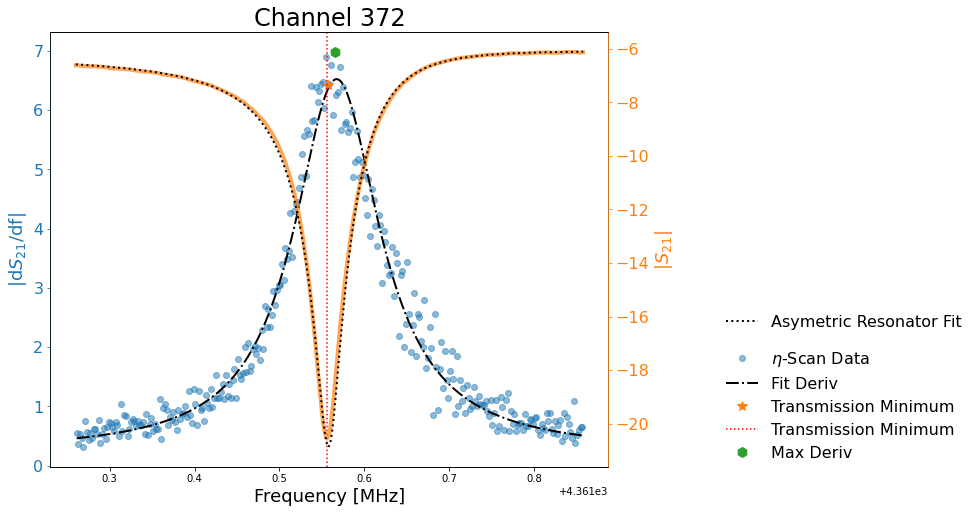

<Figure size 720x576 with 0 Axes>

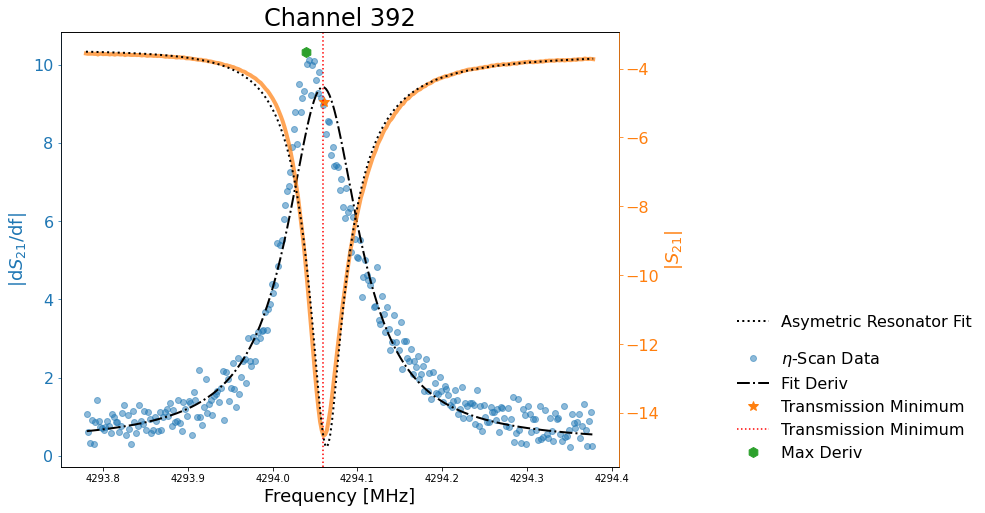

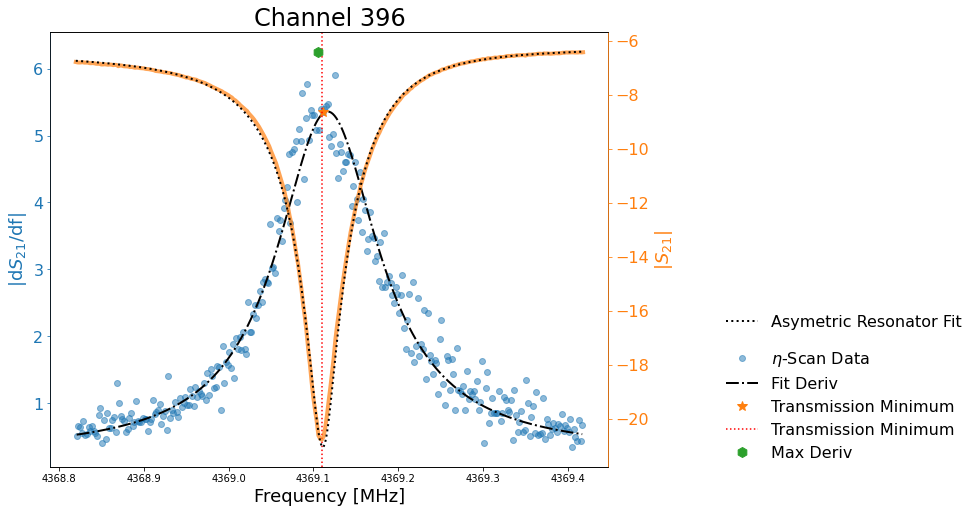

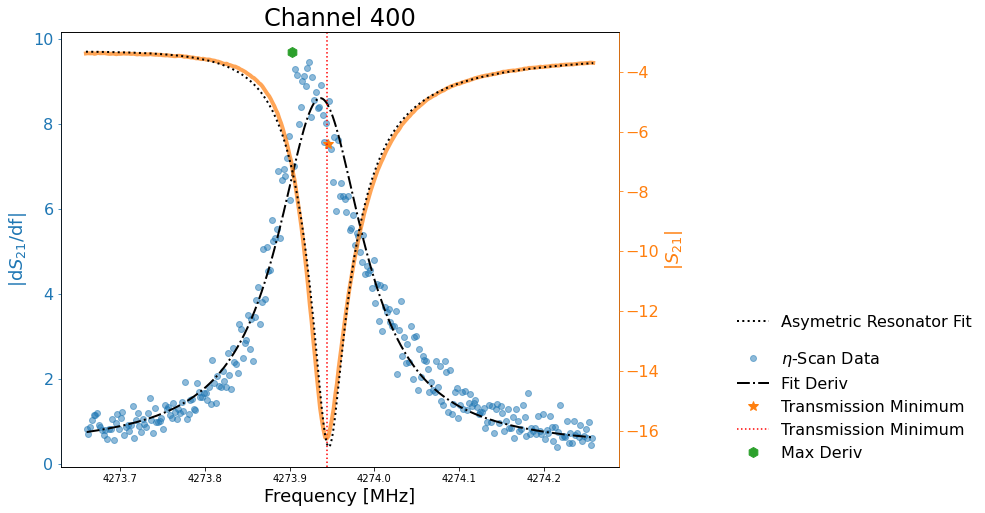

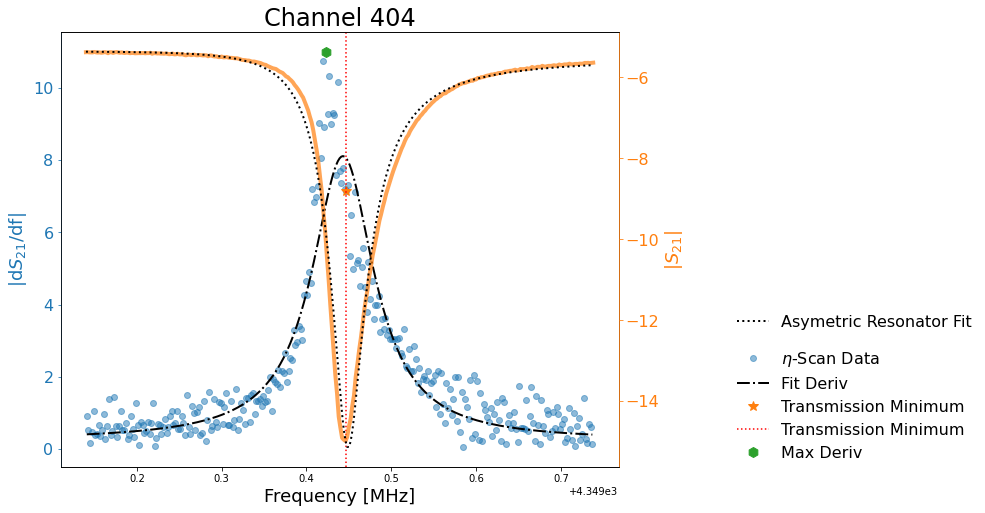

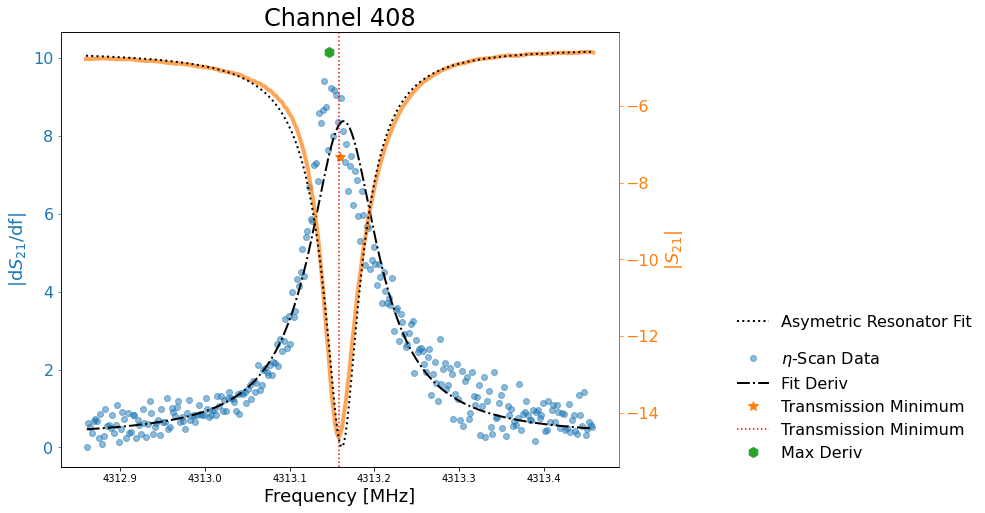

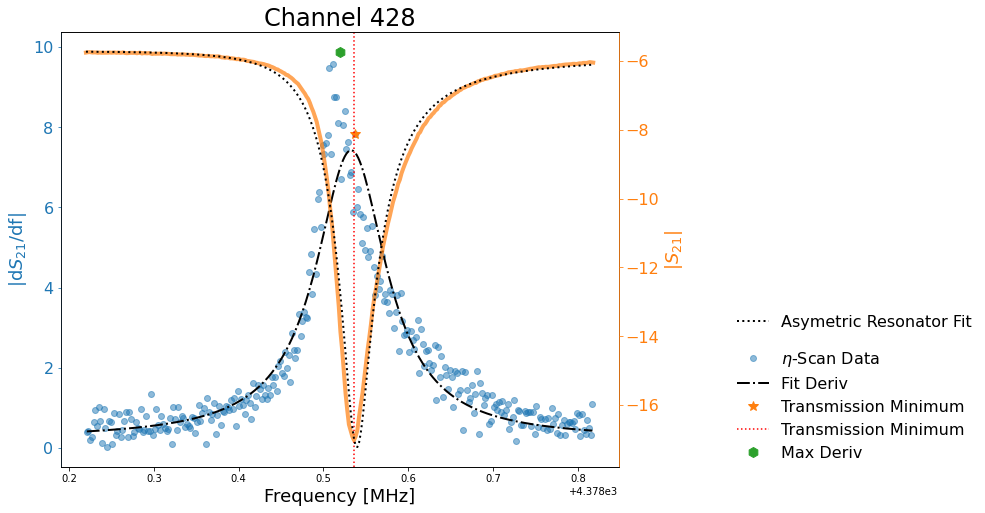

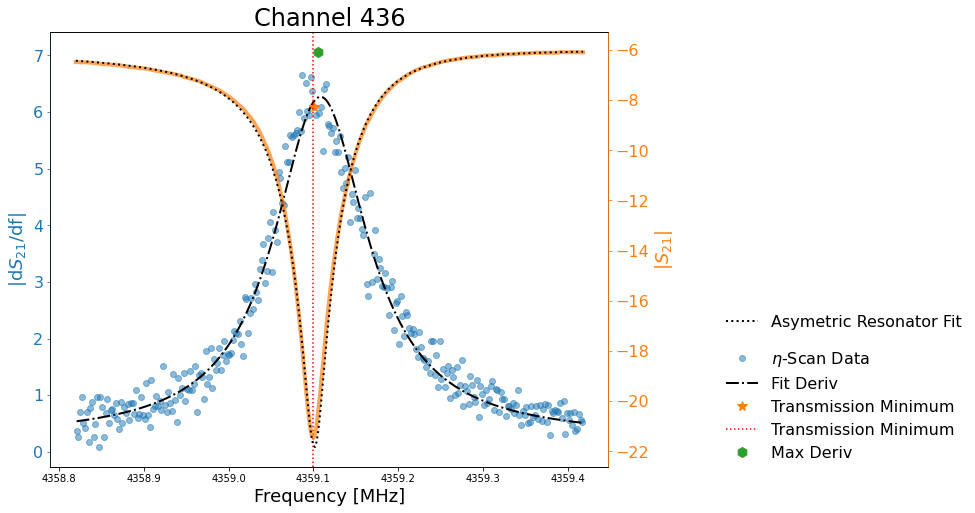

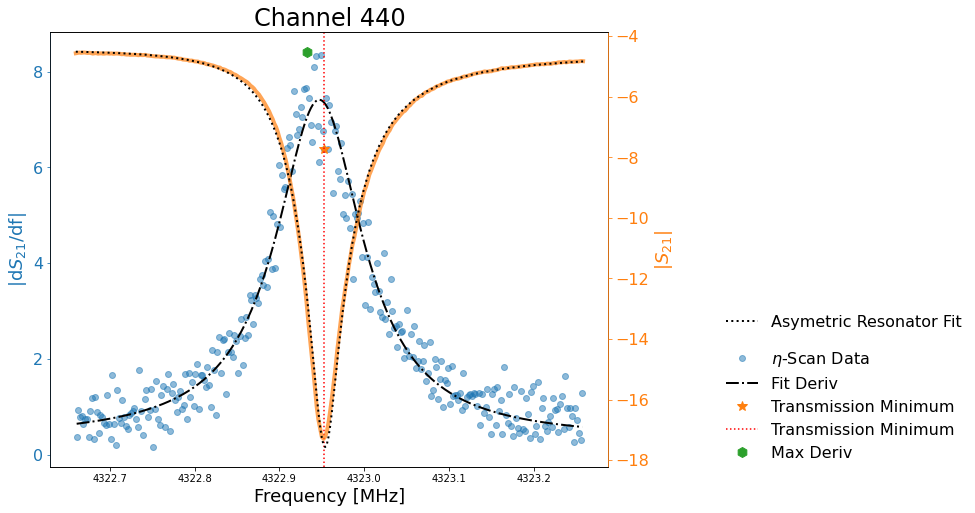

<Figure size 720x576 with 0 Axes>

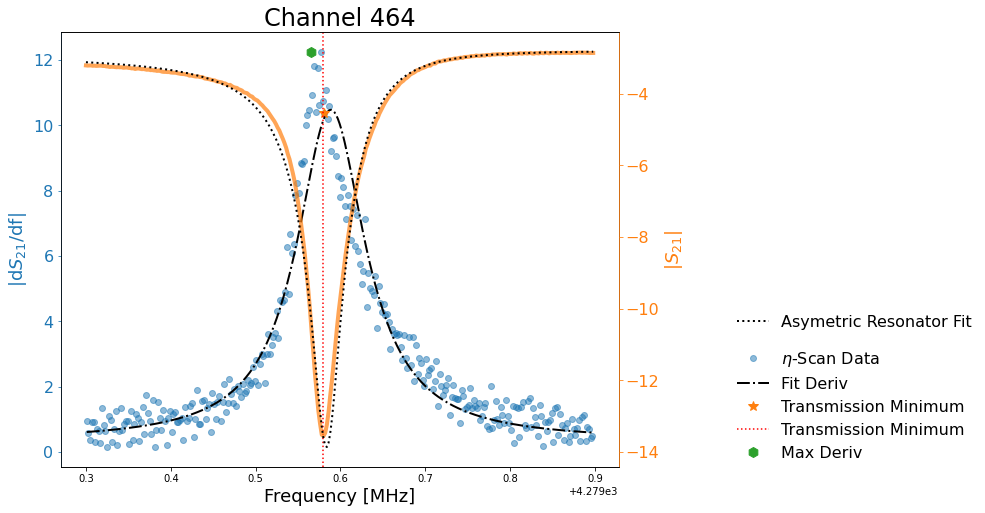

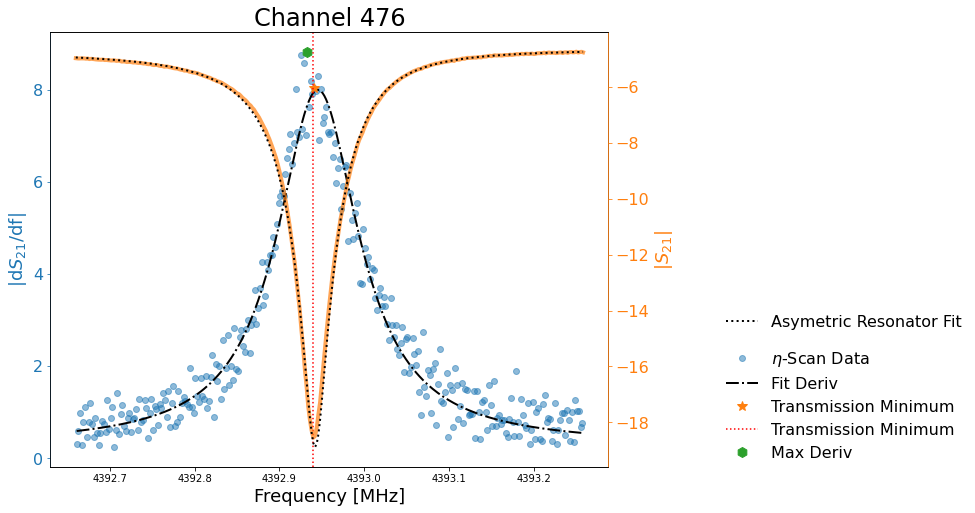

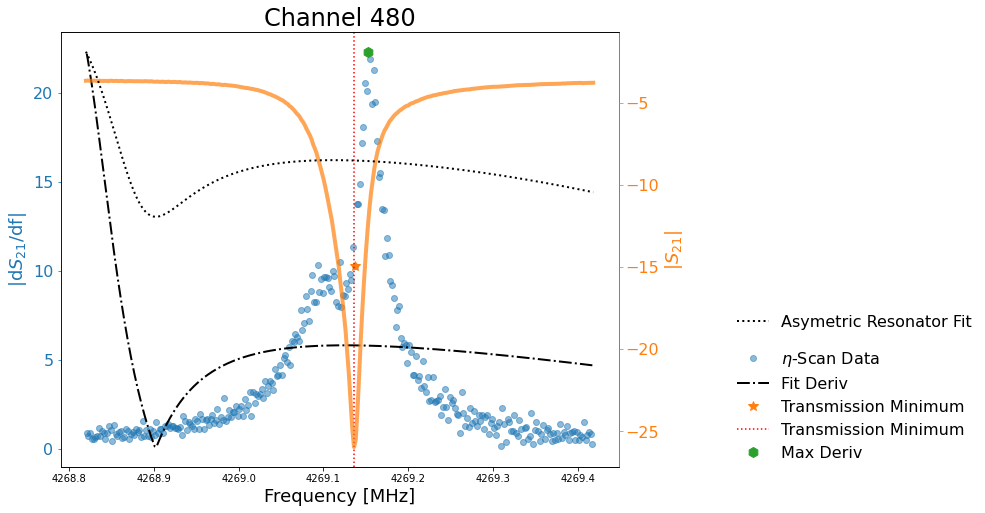

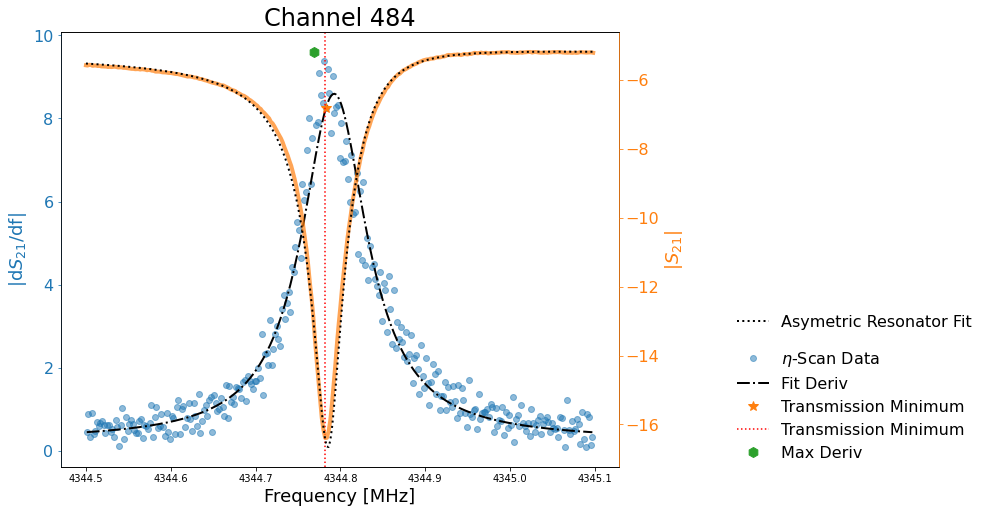

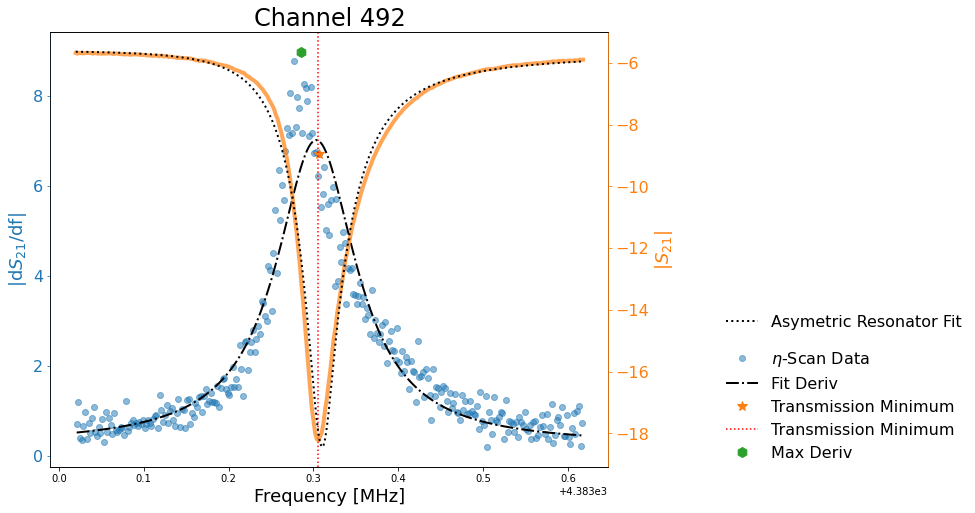

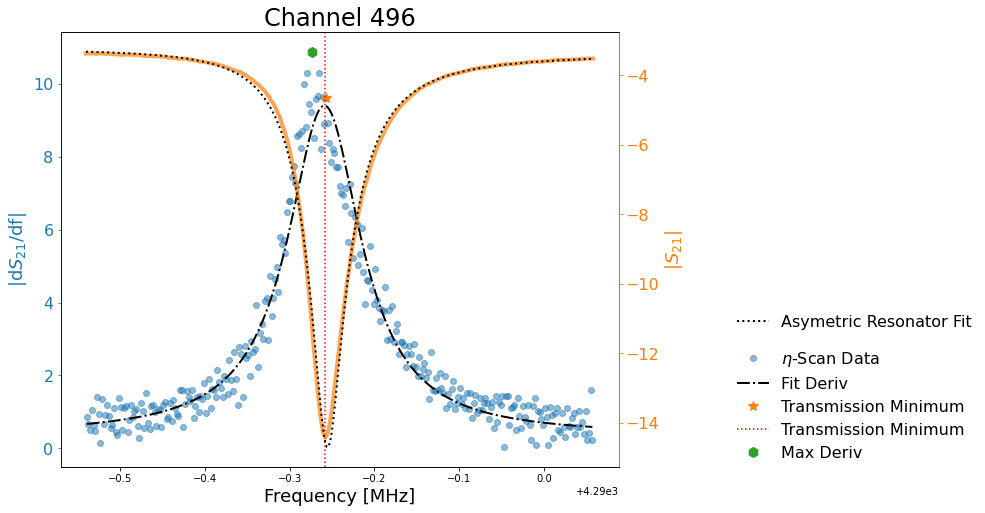

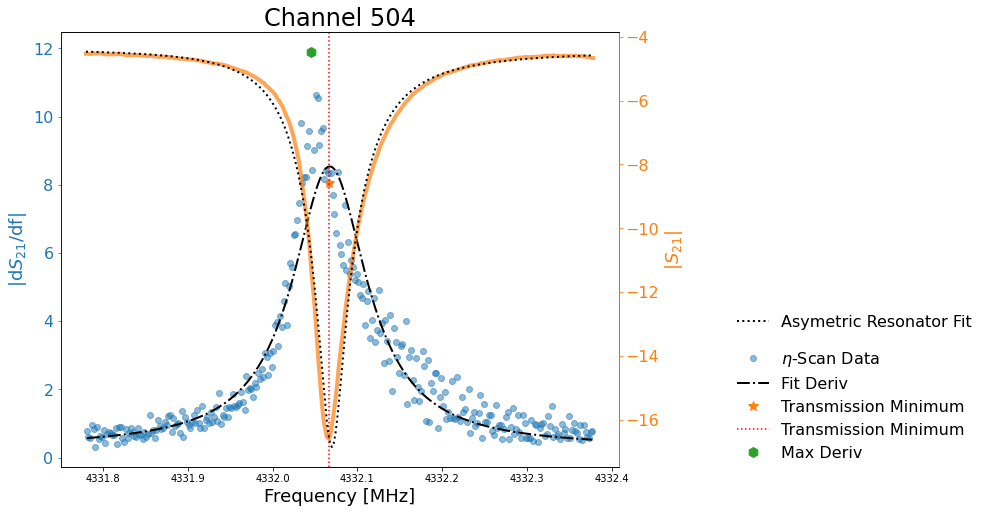

In [254]:
tunedict = np.load(S.tune_file,allow_pickle=True).item()
chan_sn = np.asarray([tunedict[band]['resonances'][key]['channel'] for key in tunedict[band]['resonances'].keys()])
for ix, k in enumerate(chans_on):
    plt.figure(figsize = (10,8))
    snch = np.where(chan_sn == k)[0][0]
    fpl = tunedict[band]['resonances'][snch]['freq_eta_scan']
    rpl = tunedict[band]['resonances'][snch]['resp_eta_scan']
    if np.ptp(20*np.log10(np.abs(rpl))) < 1:
        continue
    fidx = np.argmin(np.abs(fpl-tunedict[band]['resonances'][snch]['freq']))
    deriv_mag = np.sqrt((np.diff(np.real(rpl))/np.diff(fpl))**2+(np.diff(np.imag(rpl))/np.diff(fpl))**2)
    deriv_mag_fit = np.sqrt((np.diff(np.real(resultdict[k+512*band].best_fit))/np.diff(fpl))**2\
                            +(np.diff(np.imag(resultdict[k+512*band].best_fit))/np.diff(fpl))**2)
    cent_diff = fpl[:-1]+(fpl[1]-fpl[0])/2
    plt.plot(cent_diff,deriv_mag, 
             'o',label = '$\\eta$-Scan Data',alpha = 0.5)
    plt.plot(cent_diff,deriv_mag_fit,label = 'Fit Deriv',
            ls = '-.',color = 'k',lw = 2)
    plt.plot(cent_diff[fidx],deriv_mag[fidx], 
             '*',label = 'Transmission Minimum',
            markersize = 10)
    plt.axvline(fpl[fidx],ls = ':',color = 'red',
               label = 'Transmission Minimum')
    dmaxidx = np.argmax(np.abs(deriv_mag))
    plt.plot(cent_diff[dmaxidx],deriv_mag[dmaxidx], 
             'h',label = 'Max Deriv',
            markersize = 10)
    ax = plt.gca()
    ax2 = plt.twinx()
    ax2.plot(fpl,20*np.log10(np.abs(rpl)),'C1',lw = 4,alpha = 0.7)
    ax2.plot(fpl, 20*np.log10(np.abs(resultdict[k+512*band].best_fit)),
              'k:',label = 'Asymetric Resonator Fit',lw = 2)
    
    ax.set_ylabel('|d$S_{21}$/df|',fontsize = 18,
                 color = 'C0')
    ax.spines['left'].set_color('C0')
    ax.tick_params(axis='y', colors='C0', labelsize=16)
    ax2.set_ylabel('|$S_{21}$|',fontsize = 18,
                 color = 'C1')
    ax2.spines['right'].set_color('C1')
    ax.set_xlabel('Frequency [MHz]',fontsize = 18)
    ax2.tick_params(axis='y', colors='C1', labelsize=16)
    plt.title(f'Channel {k}',fontsize = 24)
    ax.legend(fontsize = 16,
               loc = (1.2,0),frameon=False)
    ax2.legend(fontsize = 16,
               loc = (1.2,0.3),frameon=False)

In [255]:
fpl[1] - fpl[0]

0.0020000000004074536

## Evaluate eta at Max Deriv Point

In [257]:
tunedict = np.load(S.tune_file,allow_pickle=True).item()
chan_sn = np.asarray([tunedict[band]['resonances'][key]['channel'] for key in tunedict[band]['resonances'].keys()])
eta_dmax = np.zeros(len(chans_on),dtype=complex)
for ix, k in enumerate(chans_on):
    snch = np.where(chan_sn == k)[0][0]
    fpl = tunedict[band]['resonances'][snch]['freq_eta_scan']
    rpl = tunedict[band]['resonances'][snch]['resp_eta_scan']
    if np.ptp(20*np.log10(np.abs(rpl))) < 1:
        continue
    fidx = np.argmin(np.abs(fpl-tunedict[band]['resonances'][snch]['freq']))
    deriv_mag = np.sqrt((np.diff(np.real(rpl))/np.diff(fpl))**2+(np.diff(np.imag(rpl))/np.diff(fpl))**2)
    dmaxidx = np.argmax(np.abs(deriv_mag))
    eta_dmax[ix] = (fpl[dmaxidx - 5] - fpl[dmaxidx + 5])/(rpl[dmaxidx - 5] - rpl[dmaxidx + 5])

Text(0, 0.5, 'Angle Difference [$^{\\circ}$]')

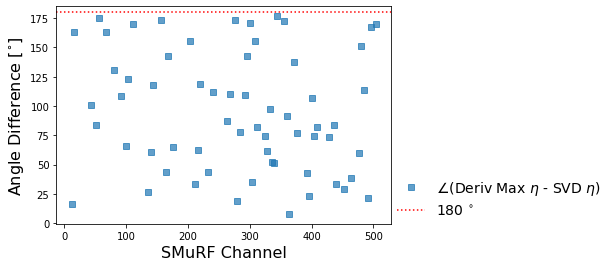

In [267]:
plt.plot(chans_on,np.abs(diff_ang(np.angle(eta_dmax,deg=True),etas_svd)),
         's',markersize = 6,alpha = 0.7)
# plt.plot(chans_on,(np.angle(eta_dmax,deg=True)+90)-etas_svd,
#          's',markersize = 6,alpha = 0.7)
plt.axhline(180,ls = ':',color = 'red')
# plt.axhline(-180,ls = '-.',color = 'red')
plt.legend(['$\\angle$(Deriv Max $\\eta$ - SVD $\\eta$)',
            '180 $^{\\circ}$',
           '-180 $^{\\circ}$'],
          fontsize = 14,loc = (1,0),frameon = False)
plt.xlabel('SMuRF Channel',fontsize = 16)
plt.ylabel('Angle Difference [$^{\\circ}$]',fontsize = 16)